# A Comprehensive Analysis of the Santander Cycle Scheme in London

## Notebook instructions and Prerequisites


Before running this notebook, please make sure you have all necessary modules installed in your environment. Potentially less common modules used include:
* google.cloud
* dotenv
* networkx
* geopandas
* praw
* transformers
* plotly.graph_objects
* ipywidgets
* folium <br>

As usual, they can be installed by running the command  *pip install [module]* in the terminal. <br> <br>
Furthermore, please make sure your Python version is compatible with all the modules. While writing this, it became apparent there might be some compatibility issues with newer Python versions (especially 3.11 and newer). In case you run into any issues, it might be worth trying to run the code with an older version such as Python 3.9. <br> <br>
Note that the commands to extract the data from BigQuery have been commented out for the sake of a simpler setup and a more efficient execution. The relevant data has beed saved in the corresponding csv-files. In case you want to run the code related to BigQuery, please make sure you have your environment set up correctly. <br> <br>
__Short Tutorial for BigQuery:__ Follow steps 1 to 6 of this tutorial to access BigQuery through a JupyterNotebook:
https://cloud.google.com/docs/authentication/provide-credentials-adc#local-dev Once you have completed step 6, follow this tutorial to setup Application Default Credentials for your local development environment: https://cloud.google.com/docs/authentication/provide-credentials-adc#local-dev Create a new file called .env in the project directory. Paste the following line into the file, replacing YOUR PROJECT ID by the ID of the project you created on the Google Cloud Platform in step 1. PROJECT_ID="YOUR PROJECT ID". You should now be able to run the notebook.


In [70]:
# uncomment to use BigQuery
# from google.cloud import bigquery
# from dotenv import load_dotenv
import numpy as np
import pandas as pd
import os
import networkx as nx
import matplotlib.pyplot as plt
import geopandas as gpd
from bs4 import BeautifulSoup
import requests
import praw
import datetime
from transformers import pipeline
import re
import plotly.graph_objects as go
from sklearn.metrics import confusion_matrix
import seaborn as sns
import ipywidgets as widgets
from IPython.display import display
import json
import folium
import plotly.express as px
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from folium.plugins import HeatMap,HeatMapWithTime
import math
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from matplotlib import cm
from sklearn.metrics import roc_curve, auc
from scipy.stats import pearsonr
from plotly.subplots import make_subplots
import branca.colormap as bcm
from matplotlib.colors import Normalize
import statsmodels.formula.api as smf
from matplotlib.cm import get_cmap

## Table of Contents <br><br>

* [1. Introduction](#1)
    * [1.1 Background](#1_1)
    * [1.2 Research Questions and Objectives](#1_2)
    * [1.3 The Dataset](#1_3)
* [2. Data Extraction](#2)
    * [2.0 Setting up the BigQuery Client](#2_1)
    * [2.1 BigQuery: Aggregating Rides by Hour](#2_2)
    * [2.2 BigQuery: Extracting Rides Per Station](#2_3)
    * [2.3 BigQuery: Aggregate Rides by Bike ID](#2_4)
    * [2.4 Imputing bike models](#2_5)
    * [2.5 BigQuery: Extracting Station Data](#2_6)
    * [2.6 Web-Scraping Strike Dates from Wikipedia](#2_7)
    * [2.7 Extracting Weather Data from Open-Meteo](#2_8)
    * [2.8 Web-Scraping Reddit Comments](#2_9)
* [3. Data Visualisation](#3)
    * [3.1 What are the most popular cycle hire stations and routes in London?](#3_1)
    * [3.2 How has the introduction of newer bike models affected their usage?](#3_2)
    * [3.3 Which factors influence the number of bike rides per day?](#3_3)
    * [3.4 Is there a connection between online activity on Reddit and bike usage?](#3_4)
* [4. Conclusion](#4)
* [5. References](#5)






## 1. Introduction <a id="1"></a>

<a id="1_1"></a>
### 1.1 Background 
In an age where climate change is emerging as one of the biggest challenges facing our planet, urban transportation, a major contributor to global $CO_2$ emissions and pollution in large cities, is inevitably taking centrestage. The drive to curb this environmental impact has led governments around the world to explore a spectrum of strategies ranging from radical solutions such as banning internal combustion engine vehicles (Winton, 2023), to transformative urban planning such as in Paris, where certain streets have been closed to car traffic. Another popular strategy involves incentivising the use of alternative means of transport. <br><br>
In line with this strategy and following the example of the *Vélib'* hiring scheme in Paris, Santander Cycles are aimed to incentivize people to use bikes for their daily urban transportation and commute (Transport for London, 2009). Since their introduction, the shared bikes, originally proposed by then Mayor Ken Livingstone and introduced in 2010 under Boris Johnson, have made a measurable contribution to reducing carbon emissions in the city in recent years.<br><br>
Since its launch, the hiring scheme has enabled more than 100 million journeys, reflecting its ever-growing popularity and acceptance among Londoners and visitors alike. The total distance covered by these journeys is staggering - more than 300 million kilometers, a distance that speaks volumes about the widespread acceptance of the system. This extensive use has a direct and significant environmental benefit: an estimated reduction of 20,000 tons of $CO_2$ emissions (Santander, 2021). This figure is a testament to the effectiveness of the system in promoting sustainable urban transportation.<br><br>
Santander Cycles are widely celebrated as a shining example of how environmentally conscious policies and practical urban solutions can work together to make a significant impact (Transport for London, 2023). This notebook aims to look past the shiny (and mostly biased) headlines to get a deeper understanding of the bike sharing infrastructure in London. It is intended to serve as an initial exploration of the publicly available data to motivate and facilitate further research on the topic.

![Photo of bikes in docking stations.](intro_bikes.jpg)

### 1.2 Research Questions and Objectives <a class="anchor" id="1_2"></a>
This investigation is guided by the following 4 __research questions__:
1. *What are the most popular cycle hire stations and routes in London?*
2. *How has the introduction of newer bike models affected their usage?*
3. *Which factors influence the number of bike rides per day?*
4. *Is there a connection between online activity on Reddit and bike usage?* <br><br>

These research questions have been curated to facilitate meeting this project's four key objectives, which are:
1. To gain a deeper understanding of where the stations are located and which stations were opened when. Gain insights how the stations are connected and which routes are frequently used. Investigate if it is possible to find clusters of stations according to usage patterns.
2. To examine the different bicycle models individually with respect to different statistics like number of rides or life span.
3. To enrich the dataset with additional information like strike and wheather data and investigate if there are any significant relationships.
4. To identify possible connections between online activity and bike hires. Investigate the link between external events related to the Santander bikes and the reactions online. Perform sentiment analysis on Reddit comments and evaluate the reliability of the employed model.


### 1.3 The Dataset <a id="1_3"></a>
The main data set in this analysis is the London Bicycle Hires data set made available by the Greater London Authority. The dataset can be accessed for free through the Google Cloud Platform https://console.cloud.google.com/marketplace/product/greater-london-authority/london-bicycles?hl=en.
<br><br>
The dataset contains two tables, cycle_stations and cycle_hire. The former contains key information on each of the 799 cycle hiring stations in London, including but not limited to its geographical coordinates and number of avaialable docks. The latter, by contrast, is an event log that contains information pertaining to nearly 80,000,000 bicyle hires from 2015 to 2023. The full schemas for both database tables are shown in tables 1.3.1 and 1.3.2. Due to limited documentation regarding the dataset, the meaning of certain fields in the dataset is unknown to the authors of this project. As these fields were not used in the in the project, the explanation for them has been left as N/A.
<br><br>
__Table 1.3.1: cycle_stations Schema__
<table>
<tr><th>Field Name <th><th> Data Type <th><th> Explanation
<tr><tr><tr><td> id <td><td> INTEGER <td><td> unique station identifier
<tr><tr><tr><td> installed <td><td> BOOLEAN <td><td> wether the station has been installed (True/False)
<tr><tr><tr><td> latitude <td><td> FLOAT <td><td> station latitude
<tr><tr><tr><td> locked <td><td> BOOLEAN <td><td> wether the station has been locked (True/False)
<tr><tr><tr><td> longitude <td><td> FLOAT <td><td> station longitude
<tr><tr><tr><td> name <td><td> STRING <td><td> station name (describes location)
<tr><tr><tr><td> bikes_count <td><td> INTEGER <td><td> number of bikes at the station
<tr><tr><tr><td> docks_count <td><td> INTEGER <td><td> number of docks at the station (station capacity)
<tr><tr><tr><td> nbEmptyDocks <td><td> INTEGER <td><td> number of empty docks (docks_count - bikes_count)
<tr><tr><tr><td> temporary <td><td> BOOLEAN <td><td> wether the station is temporary (True/False)
<tr><tr><tr><td> terminal_name <td><td> STRING <td><td> N/A
<tr><tr><tr><td> install_date <td><td> DATE <td><td> date when station was installed
<tr><tr><tr><td> removal_date <td><td> DATE <td><td> date when station was removed<td><tr>
<table>

<br><br>
__Table 1.3.2: cycle_hires Schema__
<table>
<tr><th>Field Name <th><th> Data Type <th><th> Explanation
<tr><tr><tr><td> rental_id <td><td> INTEGER <td><td> unique ride identifier (primary key)
<tr><tr><tr><td> duration <td><td> INTEGER <td><td> ride duration in seconds
<tr><tr><tr><td> duration_ms <td><td> INTEGER <td><td> ride duration in miliseconds
<tr><tr><tr><td> bike_id <td><td> INTEGER <td><td> unique bike identifier
<tr><tr><tr><td> bike_model <td><td> FLOAT <td><td> bike model
<tr><tr><tr><td> end_date <td><td> STRING <td><td> time when ride ended
<tr><tr><tr><td> end_station_id <td><td> INTEGER <td><td> unique identifier for the end station (foreign key)
<tr><tr><tr><td> end_station_name <td><td> INTEGER <td><td> the name of the end station (foreign key)
<tr><tr><tr><td> start_date <td><td> INTEGER <td><td> time when ride started
<tr><tr><tr><td> start_station_id <td><td> BOOLEAN <td><td> unique identifier for start station (foreign key)
<tr><tr><tr><td> start_station_name <td><td> STRING <td><td> name of start station (foreign key)
<tr><tr><tr><td> end_station_logical_terminal <td><td> DATE <td><td> N/A
<tr><tr><tr><td> start_station_logical_terminal <td><td> DATE <td><td> N/A
<tr><tr><tr><td> end_station_priority_id <td><td> DATE <td><td> N/A <td><tr>
<table>

## 2. Data Extraction <a id="2"></a>
This section describes the process of data extraction and cleaning.
<br><br>
As the full data set contains data regarding almost 80,000,000 bicycle hires from 2015 to 2023, it was too large to be downloaded locally. Furthermore, due to processing power and RAM limitations, even if the dataset was downloaded, its size would make it unusable in a Jupyter Notebook. To solve this issue, SQL queries were written in order to aggregate the data by hour, start station and bike id. By using 3 seperate aggregations, data granularity was maintianed whilst decreasing the number of rows processed. Additinally a query was written to extract the cycle_stations table into the notbeok. Queries were performed directly on the Google Cloud Platform using the BigQuery API. The result of each query was converted into a pandas dataframe and preprocessed.
<br>
_Since using BigQuery requires setting up user authentication credentials and acquring access to the dataset, code segements used to query the dataset have been commented out. For ease of use, dataframes extracted have been saved as csv files and can be loaded directly into the notebook._
<br><br>
Data enrichment was used to obtain more context behind cycle hiring behaviour. Namely, dates of previous London Undergound strikes were web-scraped from Wikipedia (https://en.wikipedia.org/wiki/London_Underground_strikes), and historical weather data was obtained from the Open-Meteo API. Additionally, to measure user sentiment towards bikes, Reddit comments were scraped using the Python Reddit API (PRAW).

### 2.0 Setting up the BigQuery Client <a id="2_1"></a>

In [24]:
# Setting up the BigQuery Client
"""
load_dotenv()
PROJECT_ID = os.getenv("PROJECT_ID")
client = bigquery.Client(project=PROJECT_ID)
"""

'\nload_dotenv()\nPROJECT_ID = os.getenv("PROJECT_ID")\nclient = bigquery.Client(project=PROJECT_ID)\n'

### 2.1 BigQuery: Aggregating Rides by Hour <a id="2_2"></a>
First, rides were grouped in hourly increments by counting the total number of rides between any two stations in a given hour. Additionally, a new dataframe containing the total number of rides per time of day was created by calculating the sum of all rides in each 1 hour window. This dataframe only had 24 rows, one for each hour in a day. This process was performed seperately for weekends and weekdays to allow for subsequent comparative analysis.

In [25]:
query = """
SELECT
  FORMAT_TIMESTAMP('%Y-%m-%d %H', TIMESTAMP(start_date)) AS time,
  EXTRACT(DAYOFWEEK FROM TIMESTAMP(start_date)) as weekday,
  COUNT(*) AS total_rides
FROM
  `bigquery-public-data.london_bicycles.cycle_hire`
GROUP BY
  time, weekday
ORDER BY
  time, weekday;
"""

"""
query_job  = client.query(query)
rides_per_hour = query_job.to_dataframe()
rides_per_hour.to_csv("rides_per_hour.csv")
"""

rides_per_hour = pd.read_csv("rides_per_hour.csv", index_col=0)
rides_per_hour["time"] = pd.to_datetime(rides_per_hour["time"])
rides_per_hour.head()

,time,weekday,total_rides
0,2015-01-04 00:00:00,1,182
1,2015-01-04 01:00:00,1,138
2,2015-01-04 02:00:00,1,134
3,2015-01-04 03:00:00,1,72
4,2015-01-04 04:00:00,1,47


In [71]:
def describe(df, cols):
    descriptive_df = pd.DataFrame(index=["Minimum", "Maximum", 'Mean', "Standard Deviation"])
    for col in cols:
        arr  = df[col].to_numpy()
        minimum = min(arr)
        maximum = max(arr)
        mean = np.mean(arr)
        sd = np.std(arr)
        descriptive_df[col] = [minimum, maximum, mean, sd]
    return descriptive_df

describe(rides_per_hour, ["total_rides"])

,total_rides
Minimum,1.000000
Maximum,7860.000000
Mean,1194.486271
Standard Deviation,1124.546306


In [27]:
rides_per_time_of_day = rides_per_hour.groupby(rides_per_hour['time'].dt.hour)\
                                            ['total_rides'].sum().reset_index()
rides_per_time_of_day_weekday = rides_per_hour[rides_per_hour["weekday"].isin([2,3,4,5,6])]\
                    .groupby(rides_per_hour['time'].dt.hour)['total_rides'].sum().reset_index()
rides_per_time_of_day_weekend = rides_per_hour[rides_per_hour["weekday"].isin([1,7])].groupby(\
                    rides_per_hour['time'].dt.hour)['total_rides'].sum().reset_index()
rides_per_time_of_day.head()

,time,total_rides
0,0,866714
1,1,569308
2,2,367165
3,3,252520
4,4,206360


### 2.2 BigQuery: Extracting Rides Per Station <a id="2_3"></a>
Aggregating by hour led to a singificant loss of granularity as the dataframe did not contain any information about the start and end stations of each ride. To solve this issue, rides were aggregated by route. For each pair of start and end stations, the total number of rides was counted. This method recognised that a route from station a to station b may not be equivalent to route from station b to station a. To maintain some notion of time, this process repeated for rides on weekends and weekdays, resulting in three dataframes.


In [28]:
query = """
SELECT
  cycle_hire.start_station_name,
  start_station_longitude,
  start_station_latitude,
  cycle_hire.end_station_name,
  end_station_latitude,
  end_station_longitude,
  total_rides
FROM (
  SELECT
    start_station_name,
    end_station_name,
    COUNT(*) AS total_rides
  FROM
    bigquery-public-data.london_bicycles.cycle_hire
  WHERE
    start_station_name IS NOT NULL
    AND end_station_name IS NOT NULL
  GROUP BY
    start_station_name,
    end_station_name) AS cycle_hire
INNER JOIN (
  SELECT
    name AS start_station_name,
    latitude AS start_station_latitude,
    longitude AS start_station_longitude
  FROM
    bigquery-public-data.london_bicycles.cycle_stations ) AS start_stations
ON
  start_stations.start_station_name = cycle_hire.start_station_name
INNER JOIN (
  SELECT
    name AS end_station_name,
    latitude AS end_station_latitude,
    longitude AS end_station_longitude
  FROM
    bigquery-public-data.london_bicycles.cycle_stations ) AS end_stations
ON
  end_stations.end_station_name = cycle_hire.end_station_name
ORDER BY
  start_station_name,
  end_station_name
"""

"""
query_job  = client.query(query)
rides_per_station = query_job.to_dataframe()
rides_per_station.to_csv("rides_per_station.csv")
"""

rides_per_station = pd.read_csv("rides_per_station.csv", index_col=0)
rides_per_station.head(3)

,start_station_name,start_station_longitude,start_station_latitude,end_station_name,end_station_latitude,end_station_longitude,total_rides
0,"Abbey Orchard Street, Westminster",-0.132102,51.498126,"Abbey Orchard Street, Westminster",51.498126,-0.132102,2831
1,"Abbey Orchard Street, Westminster",-0.132102,51.498126,"Aberdeen Place, St. John's Wood",51.524826,-0.176268,19
2,"Abbey Orchard Street, Westminster",-0.132102,51.498126,"Aberfeldy Street, Poplar",51.513548,-0.005659,2


In [29]:
describe(rides_per_station, ["total_rides"])

,total_rides
Minimum,1.000000
Maximum,161295.000000
Mean,139.125047
Standard Deviation,519.874577


In [30]:
query = """
SELECT
  cycle_hire.start_station_name,
  start_station_longitude,
  start_station_latitude,
  cycle_hire.end_station_name,
  end_station_latitude,
  end_station_longitude,
  total_rides
FROM (
  SELECT
    start_station_name,
    end_station_name,
    COUNT(*) AS total_rides
  FROM
    bigquery-public-data.london_bicycles.cycle_hire
  WHERE
    start_station_name IS NOT NULL
    AND end_station_name IS NOT NULL
    AND EXTRACT(DAYOFWEEK FROM TIMESTAMP(start_date)) IN (1, 7)
  GROUP BY
    start_station_name,
    end_station_name) AS cycle_hire
INNER JOIN (
  SELECT
    name AS start_station_name,
    latitude AS start_station_latitude,
    longitude AS start_station_longitude
  FROM
    bigquery-public-data.london_bicycles.cycle_stations ) AS start_stations
ON
  start_stations.start_station_name = cycle_hire.start_station_name
INNER JOIN (
  SELECT
    name AS end_station_name,
    latitude AS end_station_latitude,
    longitude AS end_station_longitude
  FROM
    bigquery-public-data.london_bicycles.cycle_stations ) AS end_stations
ON
  end_stations.end_station_name = cycle_hire.end_station_name
ORDER BY
  start_station_name,
  end_station_name
"""

"""
query_job  = client.query(query)
rides_per_station_weekend = query_job.to_dataframe()
rides_per_station_weekend.to_csv("rides_per_station_weekend.csv")
"""

rides_per_station_weekend = pd.read_csv("rides_per_station_weekend.csv", index_col=0)
describe(rides_per_station_weekend, ["total_rides"])

,total_rides
Minimum,1.000000
Maximum,68960.000000
Mean,41.722249
Standard Deviation,202.245751


In [31]:
query = """
SELECT
  cycle_hire.start_station_name,
  start_station_longitude,
  start_station_latitude,
  cycle_hire.end_station_name,
  end_station_latitude,
  end_station_longitude,
  total_rides
FROM (
  SELECT
    start_station_name,
    end_station_name,
    COUNT(*) AS total_rides
  FROM
    bigquery-public-data.london_bicycles.cycle_hire
  WHERE
    start_station_name IS NOT NULL
    AND end_station_name IS NOT NULL
    AND EXTRACT(DAYOFWEEK FROM TIMESTAMP(start_date)) IN (2, 3, 4, 5, 6)
  GROUP BY
    start_station_name,
    end_station_name) AS cycle_hire
INNER JOIN (
  SELECT
    name AS start_station_name,
    latitude AS start_station_latitude,
    longitude AS start_station_longitude
  FROM
    bigquery-public-data.london_bicycles.cycle_stations ) AS start_stations
ON
  start_stations.start_station_name = cycle_hire.start_station_name
INNER JOIN (
  SELECT
    name AS end_station_name,
    latitude AS end_station_latitude,
    longitude AS end_station_longitude
  FROM
    bigquery-public-data.london_bicycles.cycle_stations ) AS end_stations
ON
  end_stations.end_station_name = cycle_hire.end_station_name
ORDER BY
  start_station_name,
  end_station_name
"""

"""
query_job  = client.query(query)
rides_per_station_weekday = query_job.to_dataframe()
rides_per_station_weekday.to_csv("rides_per_station_weekday.csv")
"""

rides_per_station_weekday = pd.read_csv("rides_per_station_weekday.csv", index_col=0)
describe(rides_per_station_weekday, ["total_rides"])

,total_rides
Minimum,1.000000
Maximum,92335.000000
Mean,108.178251
Standard Deviation,357.861146


### 2.3 BigQuery: Aggregate Rides by Bike ID <a id="2_4"></a>
To gain a better understanding of the role different
bike models played in the bicycle hiring process, rides were aggregated by bike_id. In the original dataset, start dates and end dates contained information regarding the timezone of the rides. Since our investigation strictly focuses on bicycle hires in London, this information was irrelevant and thus these two columns were converted to standard datetime64[ms] objects in the dataframe.

In [32]:
query = """
SELECT
  bike_id,
  bike_model,
  COUNT(*) AS total_rides,
  SUM(duration) AS total_duration,
  MIN(start_date) AS start_date,
  MAX(end_date) AS end_date
FROM
  bigquery-public-data.london_bicycles.cycle_hire
WHERE
  bike_id is not null
  AND (bike_model ="CLASSIC"
  OR bike_model = "PBSC_EBIKE")
GROUP BY
  bike_id, bike_model

UNION ALL

SELECT
  bike_id,
  bike_model,
  COUNT(*) AS total_rides,
  SUM(duration) AS total_duration,
  MIN(start_date) AS start_date,
  MAX(end_date) AS end_date
FROM
  bigquery-public-data.london_bicycles.cycle_hire
WHERE
  bike_id is not null
  AND bike_id NOT IN (
    SELECT
      bike_id
    FROM
      bigquery-public-data.london_bicycles.cycle_hire
    WHERE
      bike_model ="CLASSIC"
      OR bike_model = "PBSC_EBIKE"
  )
  AND (bike_model is null
  OR bike_model = " ")
GROUP BY
  bike_id, bike_model
ORDER BY
  bike_id
"""

"""
query_job  = client.query(query)
rides_per_bike_id = query_job.to_dataframe()
rides_per_bike_id.to_csv("rides_per_bike_id.csv")
"""

rides_per_bike_id = pd.read_csv('rides_per_bike_id.csv', index_col=0)
rides_per_bike_id['bike_id'] = rides_per_bike_id['bike_id'].astype('int32')
rides_per_bike_id['total_rides'] = rides_per_bike_id['total_rides'].astype('int32')
rides_per_bike_id['bike_model'] = rides_per_bike_id['bike_model'].fillna('OTHER')
rides_per_bike_id['start_date'] = pd.to_datetime(rides_per_bike_id['start_date']).dt.tz_localize(None).astype('datetime64[ms]')
rides_per_bike_id['end_date'] = pd.to_datetime(rides_per_bike_id['end_date']).dt.tz_localize(None).astype('datetime64[ms]')
rides_per_bike_id['life_span'] = (rides_per_bike_id["end_date"] - rides_per_bike_id["start_date"]).dt.total_seconds()
rides_per_bike_id.head(3)

,bike_id,bike_model,total_rides,total_duration,start_date,end_date,life_span
0,1,OTHER,3631,5726545,2017-06-15 09:04:00,2022-09-12 20:58:00,165498840.0
1,2,CLASSIC,75,82983,2022-09-14 15:19:00,2022-10-29 20:47:00,3907680.0
2,4,CLASSIC,108,127242,2022-10-15 08:16:00,2023-01-11 19:29:00,7643580.0


In [72]:
describe(rides_per_bike_id, ["total_rides", "total_duration", "life_span"])

,total_rides,total_duration,life_span
Minimum,1.000000,8.000000e+00,0.000000e+00
Maximum,5883.000000,7.855169e+06,1.655753e+08
Mean,1737.002446,2.260347e+06,6.514550e+07
Standard Deviation,1629.099492,2.139228e+06,6.309121e+07


### 2.4 Imputing bike models <a id="2_5"></a>
In the original dataset, bike_models were labeled as either CLASSIC, PBSC_EBIKE or NULL. Due to the large number of NULL bike models, an imputation strategy was adopted. On the 30th of October 2017 a new generation of bikes, produced by Pashley Cycles, was introduced (https://www.london.gov.uk/press-releases/mayoral/next-generation-of-santander-cycles-arrive). Assuming that all bikes introduced after this date were Pashley bikes, allowed to impute their bike model as Pashley as seen in the code segment below.

In [33]:
def impute_bike_model(row):
    if row['bike_model'] == 'CLASSIC':
        if row['start_date'] >= pd.to_datetime('30/10/2017'):
            return 'PASHLEY'
        else:
            return "DEVINCI"
    if row['bike_model'] == 'OTHER':
        if row['start_date'] <= pd.to_datetime('30/10/2017'):
            return 'DEVINCI'
        else:
            return "PASHLEY"
    return row['bike_model']

rides_per_bike_id['bike_model'] = rides_per_bike_id.apply(impute_bike_model, axis=1)
set(rides_per_bike_id['bike_model'])

/var/folders/rr/fg5nr4090lvb7lzvqv111q8c0000gn/T/ipykernel_30908/421074690.py:8: UserWarning: Parsing dates in %d/%m/%Y format when dayfirst=False (the default) was specified. Pass `dayfirst=True` or specify a format to silence this warning.
  if row['start_date'] <= pd.to_datetime('30/10/2017'):
/var/folders/rr/fg5nr4090lvb7lzvqv111q8c0000gn/T/ipykernel_30908/421074690.py:3: UserWarning: Parsing dates in %d/%m/%Y format when dayfirst=False (the default) was specified. Pass `dayfirst=True` or specify a format to silence this warning.
  if row['start_date'] >= pd.to_datetime('30/10/2017'):


{'DEVINCI', 'PASHLEY', 'PBSC_EBIKE'}

### 2.5 BigQuery: Extracting Station Data <a id="2_6"></a>
Finally, station data was extracted from the dataset using BigQuery. As previously mentioned, the cycle_stations table only containes 799 rows and could thus be directly loaded into the notebook. Since station names are unique, the "name" column was set as the index of the data frame. For each station, the number of incoming and outgoing rides on weekends and weekdays was calculated. These were then used to calculate the total number of rides on weekends, weekdays and in total.

In [34]:
query = """
SELECT
  *
FROM
  bigquery-public-data.london_bicycles.cycle_stations
ORDER BY
  name
"""

"""
query_job  = client.query(query)
stations = query_job.to_dataframe()
stations.to_csv("stations.csv")
"""

stations = pd.read_csv('stations.csv', index_col=0)
stations = stations.set_index('name')
stations.head(3)

,id,installed,latitude,locked,longitude,bikes_count,docks_count,nbEmptyDocks,temporary,terminal_name,install_date,removal_date
name,,,,,,,,,,,,
"Abbey Orchard Street, Westminster",108,True,51.498126,False,-0.132102,11,29,18,False,3429,2010-07-14,NaN
"Abbotsbury Road, Holland Park",559,True,51.501391,False,-0.205991,17,24,7,False,200111,NaN,NaN
"Aberdeen Place, St. John's Wood",394,True,51.524826,False,-0.176268,9,18,9,False,2698,NaN,NaN


In [35]:
stations["rides_to_weekend"] = 0
stations["rides_from_weekend"] = 0
stations["rides_to_weekday"] = 0
stations["rides_from_weekday"] = 0

for start, end, total in zip(rides_per_station_weekend["start_station_name"],
                             rides_per_station_weekend["end_station_name"],
                             rides_per_station_weekend["total_rides"]):
    try:
        stations.loc[start, "rides_from_weekend"] += total
        stations.loc[end, "rides_to_weekend"] += total
    except:
        continue

for start, end, total in zip(rides_per_station_weekday["start_station_name"],
                             rides_per_station_weekday["end_station_name"],
                             rides_per_station_weekday["total_rides"]):
    try:
        stations.loc[start, "rides_from_weekday"] += total
        stations.loc[end, "rides_to_weekday"] += total
    except:
        continue

stations["total_rides_weekend"] = stations["rides_from_weekend"] + stations["rides_to_weekend"]
stations["total_rides_weekday"] = stations["rides_from_weekday"] + stations["rides_to_weekday"]
stations["total_rides"] = stations["total_rides_weekend"] + stations["total_rides_weekday"]
stations = stations.loc[stations['latitude'].notna()]
stations = stations.loc[stations['longitude'].notna()]
stations.head(3)


,id,installed,latitude,locked,longitude,bikes_count,docks_count,nbEmptyDocks,temporary,terminal_name,install_date,removal_date,rides_to_weekend,rides_from_weekend,rides_to_weekday,rides_from_weekday,total_rides_weekend,total_rides_weekday,total_rides
name,,,,,,,,,,,,,,,,,,,
"Abbey Orchard Street, Westminster",108,True,51.498126,False,-0.132102,11,29,18,False,3429,2010-07-14,NaN,22824,18572,112267,93404,41396,205671,247067
"Abbotsbury Road, Holland Park",559,True,51.501391,False,-0.205991,17,24,7,False,200111,NaN,NaN,12868,13314,21597,23986,26182,45583,71765
"Aberdeen Place, St. John's Wood",394,True,51.524826,False,-0.176268,9,18,9,False,2698,NaN,NaN,13614,16608,32698,40603,30222,73301,103523


In [73]:
describe(stations, ["rides_from_weekend", "rides_to_weekend",
                    "rides_from_weekday", "rides_to_weekday",
                    "total_rides_weekday", "total_rides_weekend",
                    "total_rides"])

,rides_from_weekend,rides_to_weekend,rides_from_weekday,rides_to_weekday,total_rides_weekday,total_rides_weekend,total_rides
Minimum,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00
Maximum,253229.000000,256662.000000,481429.000000,468451.000000,949880.000000,509891.000000,1.288170e+06
Mean,24867.901126,24855.205257,70357.145181,70236.204005,140593.349186,49723.106383,1.903165e+05
Standard Deviation,19563.992673,20273.858422,47926.189656,50959.160630,98524.690108,39788.397455,1.303696e+05


### 2.6 Web-Scraping Strike Dates from Wikipedia <a id="2_7"></a>
Considering the shared bicycles in a broader context as part of the London public transport (TFL), intuitively it makes sense to assume that if other parts of the system fail, there should be an increased demand for the Santander bikes. The most popular means of transport in London is arguably the Underground, so the analysis of stress phases in this mode of transport could potentially provide information about the avoidance behavior of Londoners. For this purpose, Wikipedia is scraped to obtain the strike dates of the London Underground.

In [36]:
source = 'https://en.wikipedia.org/wiki/London_Underground_strikes'
data = requests.get(source)
soup = BeautifulSoup(data.content, 'html.parser')
rows = soup.findAll('tr')
starts, ends = [], []

for row in rows[1:]:
    elems = row.findAll('td')
    starts.append(elems[0].text.split(' ')[0].split('\n')[0])
    ends.append(elems[0].text.split(' ')[0].split('\n')[0])

df_strikes = pd.DataFrame(columns=['start', 'end'])
df_strikes['start'] = starts
df_strikes['start'] = pd.to_datetime(df_strikes['start'])
df_strikes['end'] = ends
df_strikes['end'] = pd.to_datetime(df_strikes['end'])
df_strikes.head(3)

,start,end
0,2010-09-06,2010-09-06
1,2010-10-03,2010-10-03
2,2010-11-28,2010-11-28


### 2.7 Extracting Weather Data from Open-Meteo <a id="2_8"></a>
One part of the analysis in this notebook consists of evaluating the influence of external factors on the number of bike hires on any given day. Intuitively, one of the most relevant factors for the number of bicycle hires should be the weather on that day. As most likely temperature is not the only covariate influencing the decision to hire a bike or not (potentially people hire bikes on a beautiful winter day, even though it is rather cold), other relevant weather information is extracted as well. The historical weather data is obtained through the Open-Meteo API.

Key to the data:<br>
* __temp_min:__ *minimum daily temperature, Celsius*
* __temp_max:__ *maximum daily temperature, Celsius*
* __sun:__ *seconds of sunshine, following WMO definition*
* __precipitation:__ *sum of all precipitation, mm*
* __rain:__ *sum of rain, mm*
* __snow:__ *sum of snowfall, cm*
* __precipitation_hours:__ *number of hours with precipitation*

In [37]:
params_weather = {'latitude': 51.5083979664,
                  'longitude': -0.11668619992,
                  'start_date': '2015-01-04',
                  'end_date': '2023-01-15',
                  'daily': ['weather_code', 'temperature_2m_max', 'temperature_2m_min', 'sunshine_duration',
                  'precipitation_sum', 'rain_sum', 'snowfall_sum', 'precipitation_hours']}

response_weather = requests.get('https://archive-api.open-meteo.com/v1/era5',
                                                                        params=params_weather)

weather_data = response_weather.json()
weather_data_df = pd.DataFrame({'time':weather_data['daily']['time'],
                                'temp_min':weather_data['daily']['temperature_2m_min'],
                                'temp_max':weather_data['daily']['temperature_2m_max'],
                                'sun':weather_data['daily']['sunshine_duration'],
                                'precipitation':weather_data['daily']['precipitation_sum'],
                                'rain':weather_data['daily']['rain_sum'],
                                'snow':weather_data['daily']['snowfall_sum'],
                                'precipitation_hours':weather_data['daily']['precipitation_hours'],
                               })
weather_data_df.head(3)

,time,temp_min,temp_max,sun,precipitation,rain,snow,precipitation_hours
0,2015-01-04,-0.2,3.8,22337.49,0.0,0.0,0.0,0.0
1,2015-01-05,4.0,9.5,1098.00,0.0,0.0,0.0,0.0
2,2015-01-06,1.3,10.0,4835.89,0.2,0.2,0.0,1.0


In [38]:
describe(weather_data_df, ["temp_min", "temp_max", "sun", "precipitation",
                           "rain", "snow", "precipitation_hours"])

,temp_min,temp_max,sun,precipitation,rain,snow,precipitation_hours
Minimum,-10.200000,-0.700000,0.000000,0.000000,0.000000,0.000000,0.000000
Maximum,20.900000,38.000000,55050.140000,35.200000,35.200000,8.680000,24.000000
Mean,7.547444,15.055385,25914.868623,1.890627,1.861179,0.020757,3.801295
Standard Deviation,5.211577,6.173670,16097.538641,3.644186,3.607092,0.275132,4.790682


### 2.8 Web-Scraping Reddit Comments <a id="2_9"></a>
In a final step, all comments from the London subreddit r/london on the topic of 'Santander Bikes' are extracted using the reddit API. For data privacy reasons, only the body of the comment and the date of the post are scraped and not the usernames. For later analysis, the comments are cleaned, meaning deleted comments are removed, as well as most special characters and links. In a later section, the comments are further filtered for certain keywords to get a more meaningful result and to avoid spam which could possibly distort the results.



In [39]:
#Extract the comments
reddit = praw.Reddit(client_id='DzqPa2avmViOiUxDF8ZzqQ',
                     client_secret='6-nA71dcCA261Dc6EqJcPH3GPky6-g',
                     user_agent='notebook:ST445_analysis:v1.0 (by /u/WorldLess1325)')

subreddit = reddit.subreddit('london')
search_query = 'Santander Bikes'

comments_about_santander_bikes = []
for submission in subreddit.search(search_query, syntax='lucene', time_filter='all'):
    submission.comments.replace_more(limit=None)
    for comment in submission.comments.list():
        comments_about_santander_bikes.append(
            [datetime.datetime.utcfromtimestamp(comment.created_utc).strftime('%Y-%m-%d %H:%M:%S'),
             comment.body])

comments_bikes_df = pd.DataFrame(comments_about_santander_bikes, columns = ['Date', 'Comment'])
comments_bikes_df['Date'] = pd.to_datetime(comments_bikes_df['Date'], format='%Y-%m-%d %H:%M:%S')
comments_bikes_df = comments_bikes_df.sort_values('Date')
comments_bikes_df = comments_bikes_df.reset_index(drop=True)
comments_bikes_df['Date'] = pd.to_datetime(comments_bikes_df['Date']).dt.date

def preprocess_comments(comment):
    comment = ' '.join(re.sub(r"(@[A-Za-z0-9_]+)|([^0-9A-Za-z'.:?! \t])|(\w+:\/\/\S+)",
                              ' ', comment).split())
    return comment

comments_bikes_df = comments_bikes_df[comments_bikes_df['Comment'] != '[deleted]'].copy()
comments_bikes_df['Cleaned Comment'] = comments_bikes_df['Comment'].apply(preprocess_comments)

post_counts = comments_bikes_df.groupby('Date').size()
post_counts.index = pd.to_datetime(post_counts.index)
post_counts_complete = post_counts.reindex(pd.date_range(start=post_counts.index.min(),
                                                        end=post_counts.index.max()),
                                                        fill_value=0)
post_counts_df = post_counts_complete.reset_index()
post_counts_df.columns = ['Date', 'Count']

comments_bikes_df.head(3)

,Date,Comment,Cleaned Comment
0,2015-02-06,Are they gonna be red now?\n\nEdit: I just rea...,Are they gonna be red now? Edit: I just read t...
1,2015-02-06,Ugh at least Coke didn't get it. Imagine being...,Ugh at least Coke didn't get it. Imagine being...
2,2015-02-06,Now the London eye and bikes are going to matc...,Now the London eye and bikes are going to matc...


## 3. Data Visualisation <a id="3"></a>
This section deals with what is probably the most important part of the whole analysis: the visualisation. The section is divided into four subsections each dealing with another nuance of the data. The first section visualises data on the docking stations and popular routes, the second segment analyses the different bike models, while the third part is dedicated to the analysis of the influence of the external factors on the number of bicycle hires. Finally, the fourth section analyses a more abstract aspect of the data: the perception online towards the hire schemes. In this context, the classification of the comments according to their sentiment is evaluated.

### 3.1 What are the most popular cycle hire stations and routes in London? <a id="3_1"></a>
<br>
Everyone who has been to London has most certainly noticed the docking stations for the Santander bikes which can be found all over the city. But how many are there really? And where are they located? Are some of them frequently used together? Among others, this section aims to answer these questions.
For this purpose, mainly the original data set obtained through BigQuery is used.
<br><br>

__OBJECTIVES:__ Find out where the bike stations are located in London. Are they evenly distributed or are there some areas with significantly more stations than others? When were the stations opened? Which stations are the most popular? Are the most popular stations the same on the weekend as on weekdays? Which stations are frequently used together? Can we cluster the stations to 'net outflow' and 'net inflow' of bikes?

In [40]:
map_all_stations = folium.Map(zoom_start=13,
               tiles='https://api.mapbox.com/styles/v1/mapbox/satellite-v9/tiles/256/{z}/{x}/{y}@2x?access_token=pk.eyJ1IjoibWFwbWFzdGVyMTIzIiwiYSI6ImNscjlnd3F4OTAwc2MybHMwbjQyMDlscnYifQ.8SGBSIcxJYjZikZ65n8_5w',
               attr='Mapbox',
               min_zoom=12)

for station in stations.index:
    folium.Marker(location=[stations.loc[station, 'latitude'], stations.loc[station, 'longitude']],
                  icon=folium.Icon(color='darkblue', prefix='fa',icon='bicycle'),
                  popup=station).add_to(map_all_stations)

map_all_stations.fit_bounds([stations[['latitude', 'longitude']].min().values.tolist(),
                  stations[['latitude', 'longitude']].max().values.tolist()])

map_all_stations

In [41]:
heat_open_df = stations[['longitude','latitude']].copy()
heat_open_df['intensity'] = 1
heat_data = heat_open_df[['latitude', 'longitude', 'intensity']].values.tolist()

heat_map_stations = folium.Map(location=(51.5083979664, -0.11668619992),
                zoom_start=12,
                tiles='https://api.mapbox.com/styles/v1/mapbox/satellite-v9/tiles/256/{z}/{x}/{y}@2x?access_token=pk.eyJ1IjoibWFwbWFzdGVyMTIzIiwiYSI6ImNscjlnd3F4OTAwc2MybHMwbjQyMDlscnYifQ.8SGBSIcxJYjZikZ65n8_5w',
                attr='Mapbox')
HeatMap(heat_data, max_opacity=0.2, blur=30).add_to(heat_map_stations)

heat_map_stations

The above two viusalisations illustrate the locations of the 799 individual docking stations (Q1 2023), and provied a heatmap superimposed on the map of London where 'more heat' indicates more stations. These visualisations confirm that the stations are not distributed evenly in London. In general it is evident that most stations are in central London, and the further one moves away from the city center, the fewer stations can be found, which does not really come as a surprise. Interestingly, however, the stations are distributed in a slightly more complex fashion: even outside of the city center there are certain 'hot spots' with a high density of bike stations including office areas like Canary Wharf or train stations like Waterloo station in South London. <br> In general it seems like there are far fewer stations south of the Thames than north of the river.


In [42]:
heat_open_time_df = stations[['latitude','longitude','install_date']].copy()
heat_open_time_df['intensity'] = 1
heat_open_time_df = heat_open_time_df.dropna()
heat_open_time_df['install_date'] = pd.to_datetime(heat_open_time_df['install_date'])\
                                    .dt.to_period('q')

heat_open_time_index = list(heat_open_time_df['install_date'].sort_values().astype('str')\
                                    .unique())

heat_per_day_list = []

for date in heat_open_time_index:
    heat_per_day_list.append(heat_open_time_df[heat_open_time_df['install_date'] == date]\
                                     [['latitude','longitude','intensity']].values.tolist())

heat_map_time = folium.Map(location=(51.5083979664, -0.11668619992),
                tiles='https://api.mapbox.com/styles/v1/mapbox/satellite-v9/tiles/256/{z}/{x}/{y}@2x?access_token=pk.eyJ1IjoibWFwbWFzdGVyMTIzIiwiYSI6ImNscjlnd3F4OTAwc2MybHMwbjQyMDlscnYifQ.8SGBSIcxJYjZikZ65n8_5w',
                attr='Mapbox',
                zoom_start=12)

HeatMapWithTime(heat_per_day_list,
                index=heat_open_time_index,
                auto_play=True,
                use_local_extrema=True,
                max_opacity=0.4,
                blur = 0.75
               ).add_to(heat_map_time)

heat_map_time

The above animation shows a heatmap of newly opened docking stations per quarter over time. What immediately becomes apparent is that most stations have been opened during the early days of the hiring scheme (i.e. in 2010). Two years later during phase 2 of the project - possibly in connection with the Olympic Summer Games 2012 - relatively many stations were opened in east London, close to the Olympic Park. At the end of the following year, quite a few stations opened in west London (phase 3), followed by only few new openings in the subsequent years. In 2018, a couple of rather remote docking stations were opened in Brixton. More recently there have not been many new openings. <br>Interestingly, after Santander took over the sponsorship in 2015 there have been comparatively few openings compared to the early days of the scheme sponsored by Barclays. However, this is to be expected since most 'strategic locations' already have been equipped with docking stations during the initial phase of the program.

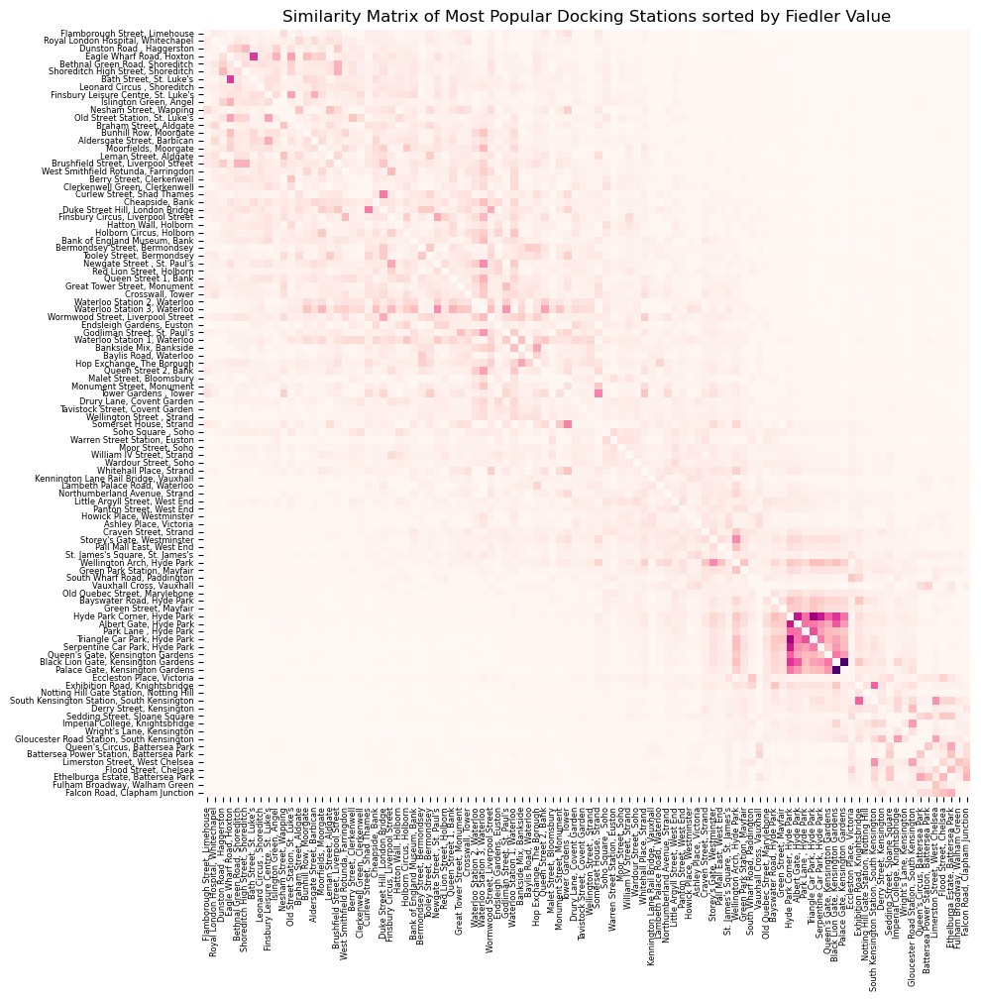

In [43]:
#takes several minutes to run
top_100_stations = stations.sort_values("total_rides", ascending=False).head(100)

adjacency_matrix = pd.DataFrame(0, index = top_100_stations.index, columns=top_100_stations.index,dtype=float)

for start in adjacency_matrix.index:
    for end in adjacency_matrix.columns:
        try:
            total = rides_per_station[(rides_per_station["start_station_name"] == start) &
                                    (rides_per_station["end_station_name"] == end)].iloc[0,6]
            if start != end:
                total += rides_per_station[(rides_per_station["end_station_name"] == start) &
                                        (rides_per_station["start_station_name"] == end)].iloc[0,6]
        except:
            total = 0

        adjacency_matrix.loc[start, end] = total
        adjacency_matrix.loc[end, start] = total

adjacency_matrix

cosine_similarity_matrix_arr = np.zeros(shape=(100, 100))

for i, start in enumerate(adjacency_matrix.index):
    for j, end in enumerate(adjacency_matrix.columns):
        if start == end:
            cosine_similarity_matrix_arr[i][j] = 0
            continue
        cosine_similarity_matrix_arr[i][j] = adjacency_matrix.loc[start, end] / (np.sqrt(stations.loc[start, "total_rides"])
                                                                           * np.sqrt(stations.loc[end, "total_rides"]))

cosine_similarity_matrix = pd.DataFrame(data=cosine_similarity_matrix_arr, columns=adjacency_matrix.columns, index=adjacency_matrix.index)

# sort according to Fiedler values
d = cosine_similarity_matrix.sum(axis = 1)
D = np.diag(d)
L = D - cosine_similarity_matrix
w, v = np.linalg.eigh(L)
eigen_idx = w.argsort()
w = w[eigen_idx]
v = v[:,eigen_idx]
fiedler_vector = v[:,1]
seriation_idx = fiedler_vector.argsort()
cosine_similarity_matrix_sorted = cosine_similarity_matrix.iloc[seriation_idx, seriation_idx]

plt.figure(figsize=(10, 10))
h = sns.heatmap(cosine_similarity_matrix_sorted, xticklabels=True, yticklabels=True, cmap = "RdPu", cbar=False)
h.set_xlabel("")
h.set_ylabel("")
plt.xticks(fontsize=6)
plt.yticks(fontsize=6)
plt.tight_layout()
plt.title('Similarity Matrix of Most Popular Docking Stations sorted by Fiedler Value')
plt.show()

To get a more nuanced understanding of the most popular routes (pairs of start and end stations), the cosine similarity between stations was computed, with a high value indicating that the two stations are frequently used together. Due to computational limitations this was only done for the 100 most popular stations judged by total number of rides. It is important to note that the process of calculating the cosine similarity matrix assumed that for any two stations a and b, the route from a to b was equivalent to the route from b to a. This avoided having to compute two separate matrices for incoming and outgoing rides. Hence, the cosine similarity was calculated as:
<br><br>$ cos(a,b)= \frac{a \cdot b}{|a||b|}= \frac{n_{a,b}+n_{b,a}}{\sqrt{n_a}*\sqrt{n_b}} $<br><br> Where $n_{a,b}$ is the number of rides from a to b and vice versa, and $n_{a}$, $n_{b}$ are the number of total rides to and from stations a and b respectively.
<br><br>
The above heatmap visualises the cosine similarity of the top 100 most popular stations (judged by total rides) with respect to their co-usage ordered according to their monotonic order derived from the Fiedler value. It does not come as a surprise that the stations which are the furthest apart in our visualisation (*Flamborough Street, Limehouse* and *Falcon Road, Clapham Junction*) are also very far apart geographically leading to few rides between the two stations. Besides some individual strong connection between stations and some minor clusters, there is a clear cluster among the stations around Hyde Park, which makes sense intuitively. It seems like many people hire a bike from one station near Hyde Park, drive around for a while (possibly in Hyde Park) and then drop off their bike at another nearby station.<br>
Interestingly, Waterloo station 2 and 3, which are located right next to each other show a very similar usage pattern, which does make sense intuitively as commuters most likely are indifferent between the two stations. Furthermore, there are only very few trips from one of the stations to the other, which also seems to make sense.

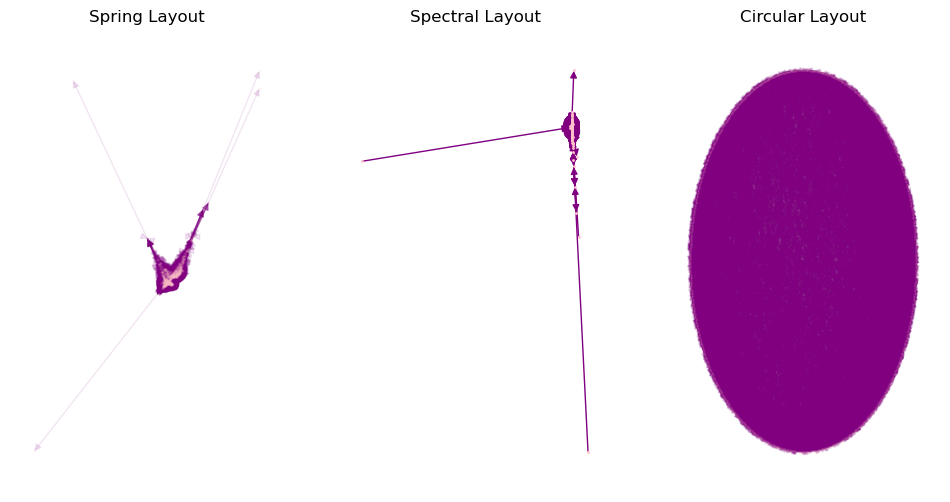

In [44]:
threshold = 1000
df = rides_per_station[rides_per_station["start_station_name"] != rides_per_station["end_station_name"]]
df = df[df["total_rides"] >= threshold]


start_stations_arr = set(df["start_station_name"])
end_stations_arr = set(df["end_station_name"])
stations_arr = start_stations_arr.union(end_stations_arr)

network = nx.DiGraph()

coordinates = {}
for station in stations_arr:
    try:
        latitude = stations.loc[station, 'latitude']
        longitude = stations.loc[station, 'longitude']
        coordinates[station] = (longitude, latitude)
        network.add_node(station)
    except:
        continue

for start, end, weight in zip(df["start_station_name"],
                             df["end_station_name"],
                             df["total_rides"]):
    network.add_edge(start, end, weight=weight)


fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(12,6))

# nx.draw(network, nx.random_layout(network),ax=ax1, with_labels=False, node_size=1, node_color='pink', edge_color='purple')
nx.draw(network, nx.spring_layout(network),ax=ax1, with_labels=False, node_size=1, node_color='pink', edge_color='purple', alpha=0.1)
nx.draw(network, nx.spectral_layout(network),ax=ax2, with_labels=False, node_size=1, node_color='pink', edge_color='purple', alpha=1)
nx.draw(network, nx.circular_layout(network),ax=ax3, with_labels=False, node_size=1, node_color='pink', edge_color='purple', alpha=0.1)

# ax1.set_title("Random Layout")
ax1.set_title("Spring Layout")
ax2.set_title("Spectral Layout")
ax3.set_title("Circular Layout")
plt.show()

In [45]:
network_description = pd.DataFrame(index=["number of nodes", "number of edges",
                                          "minimum degree", "maximum degree",
                                          "mean degree"])
degrees = dict(network.degree)
network_description["value"] = [len(network.nodes), len(network.edges),
                                min(degrees.values()), max(degrees.values()),
                                np.mean(list(degrees.values()))]
network_description

,value
number of nodes,754.000000
number of edges,10944.000000
minimum degree,1.000000
maximum degree,257.000000
mean degree,29.029178


Next, networkx was used to construct a directed acyclic (DAG) graph of routes. To do so, rides with the same start and end station were excluded. Additionally, due to computational limitations, a minimum ride threshold was set at a 1000. Routes (pairs of two unique stations) with less then 1000 rides were also excluded. This was done to exlude unpopular routes which may not have been representative of general cycling trends. Each node in the graph represents a station and each edge a route. For each edge, the weight was set to the total number of rides for the route.
<br><br>
The resulting graph had 754 nodes (stations) and 10944 edges. Interestingly, this means that a graph constructed at a 1000 ride threshold accounted for almost 95% of the all stations (799). In other words, ~95% of the stations had at least one route with 1000 or more total rides. A mean node degree of 29 indicates that on average, a station is connected by a popular route to 29 other stations.
<br><br>
Several graph layout algorithms were tested to display the graph, with little to no success as seen in the figure above. What is most striking is how the circular layout is completely filled with edges, resembling a solid oval. This is most likely caused by the high mean node degree. In this scenario, it might make more sense to use geographical coordinates for node positions.

In [46]:
map_graph = folium.Map(location=(51.5083979664, -0.11668619992),
                zoom_start=12,
                tiles='https://api.mapbox.com/styles/v1/mapbox/light-v11/tiles/256/{z}/{x}/{y}@2x?access_token=pk.eyJ1IjoibWFwbWFzdGVyMTIzIiwiYSI6ImNscjlnd3F4OTAwc2MybHMwbjQyMDlscnYifQ.8SGBSIcxJYjZikZ65n8_5w',
                attr='Mapbox')

vmin=min(stations["total_rides"])
vmax=max(stations["total_rides"])
color_map = bcm.linear.plasma.scale(vmin=vmin, vmax=vmax)
norm = Normalize(vmin=vmin, vmax=vmax)

for station in stations_arr:
    try:
        color = color_map(stations.loc[station, "total_rides"])
        radius = norm(stations.loc[station, "total_rides"])
        folium.Circle(
            location=[stations.loc[station, 'latitude'], stations.loc[station, 'longitude']],
            color=color,
            fillOpacity=1,
            fill=True,
            radius=2*radius,
            popup=station
        ).add_to(map_graph)
    except:
        continue

vmin=min(rides_per_station["total_rides"])
vmax=max(rides_per_station["total_rides"])
color_map = bcm.linear.plasma.scale(vmin=vmin, vmax=vmax)
norm = Normalize(vmin=vmin, vmax=vmax)

for (start, end, data) in network.edges(data=True):
    try:
        weight = norm(data["weight"])
        color = color_map(weight)
        folium.PolyLine([[stations.loc[start, 'latitude'], stations.loc[start, 'longitude']],
                        [stations.loc[end, 'latitude'], stations.loc[end, 'longitude']]],
                        weight=5*weight, color=color,
                        opacity=0.8).add_to(map_graph)
    except:
        continue


map_graph

To better understand the most popular routes from a geographical perspective, true coordinates of each station were used to position the nodes in the graph. Here, line thickness represents the total number of rides for each route and the station colour represents its corresponding total number of rides. From the resulting graph superimposed onto a map of London, two main clusters of routes emmerge. Firstly, there is a large amount of rides between Waterloo Station and the City of London (a major buisness district). Secondly, there appears to be a large amount of journeys around Hyde Park. Both observations align with what was previously discovered by the cosine similarity Matrix; most popular routes and stations are found in these two areas of London.

__Findings__
* There are docking stations all over London, however most of them can be found in central London between Hyde Park and the City.
* There are some hotspots with many docking stations, for example close to train staitons like Waterloo station, parks such as Hyde park or in the vicinity of Universities like LSE and Kings College.
* Some of the most popular stations judged by total number of rides include the docking stations around Hyde park indicating high recreational use of the bikes.
* Furthermore it seems like the stations around Hyde Park are frequently used together providing further evidence for recreational use of the bikes in that area.
* Depending on the location of the station it seems likely that the bikes are either mostly used for recreational use of for the daily commute, leading to very different usage patterns. It seems like bikes which are mostly used for recreational use are frequently returned to another docking station close to the start station (Hyde Park), whereas bikes mostly used for the daily commute are distributed around nearby office districts (Waterloo station).

### 3.2 How has the introduction of newer bike models affected their usage? <a id="3_2"></a>
Since its inception in 2010, the London cycle hire scheme has introduced 3 generations of bikes. Whilst initially produced by DeVinci (https://www.theglobeandmail.com/news/world/london-to-launch-bike-hire-scheme-with-quebec-made-cycles/article1387499/), 2017 saw a change as a second generation of bikes, produced by Pashley (https://www.pashley.co.uk/blogs/pashley/pashley-s-new-hire-bike-for-london), was launched. This new generation of bikes was advertised as having improved "handling", "safety" and "comfort". Finally, 2022 saw the introduction of E-bikes, allowing for commuters to travel further distances in shorter time (https://www.ianvisits.co.uk/articles/testing-tfls-new-e-bike-hire-scheme-57992/). This section tackles question, how has the introduction of newer bike models affected their usage by commuters.
<br><br>
__Objectives:__ How has the number of bikes for each model changed over time? How does average ride duration differ for different bike models? Can different bike models be clustered based on quantiative features?  

![bike models](bike_models.png)
__Figure 3.2.1:__ Photos of Pashley bike (left), Ebike (top right) and DeVinci bike (bottom right)

In [47]:
first_quarter = rides_per_bike_id['start_date'].min().to_period("Q")
last_quarter = rides_per_bike_id['end_date'].max().to_period("Q")
quarters = []
active_pashley_arr = []
active_devinci_arr = []
active_ebike_arr = []

current_quarter = first_quarter
while current_quarter <= last_quarter:
    pashley_mask = (rides_per_bike_id['start_date'].dt.to_period("Q") <= current_quarter) & \
    (rides_per_bike_id['end_date'].dt.to_period("Q") >= current_quarter) & \
    (rides_per_bike_id['bike_model'] == "PASHLEY")
    devinci_mask = (rides_per_bike_id['start_date'].dt.to_period("Q") <= current_quarter) & \
    (rides_per_bike_id['end_date'].dt.to_period("Q") >= current_quarter) & \
    (rides_per_bike_id['bike_model'] == "DEVINCI")
    ebike_mask = (rides_per_bike_id['start_date'].dt.to_period("Q") <= current_quarter) & \
    (rides_per_bike_id['end_date'].dt.to_period("Q") >= current_quarter) & \
    (rides_per_bike_id['bike_model'] == "PBSC_EBIKE")

    active_pashley_arr.append(rides_per_bike_id[pashley_mask]['bike_id'].count())
    active_devinci_arr.append(rides_per_bike_id[devinci_mask]['bike_id'].count())
    active_ebike_arr.append(rides_per_bike_id[ebike_mask]['bike_id'].count())

    quarters.append(current_quarter)
    current_quarter += 1

active_bikes = pd.DataFrame(columns=["quarter", "active_pashley", "active_devinci", "active_ebike"])
active_bikes["quarter"] = quarters
active_bikes["active_pashley"] = active_pashley_arr
active_bikes["active_devinci"] = active_devinci_arr
active_bikes["active_ebike"] = active_ebike_arr

fig = go.Figure()

fig.add_trace(go.Bar(x=active_bikes['quarter'].astype(str),
                         y=active_bikes['active_pashley'],
                         name='Active Pashley Bikes',
                         marker=dict(color='purple')))
fig.add_trace(go.Bar(x=active_bikes['quarter'].astype(str),
                         y=active_bikes['active_devinci'],
                         name='Active DeVinci Bikes',
                         marker=dict(color='pink')))
fig.add_trace(go.Bar(x=active_bikes['quarter'].astype(str),
                         y=active_bikes['active_ebike'],
                         name='Active PBSC Ebikes',
                         marker=dict(color='salmon')))

fig.update_layout(title='<b>Number of Active Bikes Over Time<b>',
                  xaxis_title='Quarter',
                  yaxis_title='Number of Active Bikes',
                #   barmode='overlay',
                  template='plotly_white')

fig.show()

A bar plot of the number of active bikes paints a clear picture of the transition from first generation DeVinci bikes to second generation Pashley bikes betweeen 2017 and 2023. Since the introduction of Pashley bikes in the 3rd quarter of 2017, the number of DeVinci bikes steadily decreased until the 4th quarter of 2022 when they were fully decomissioned. Interestingly, this coincides with the quarter when E-bikes were introduced, however, their number is very low compared to other bikes. The number of active Pashley bikes, on the other hand, grew steadily until Q3 2022 where the number suprisingly tripled. The following quarters, however, saw a decrease in the number of these bikes, perhaps as their initial over-supply adjusted to their demand.

In [48]:
pashley = rides_per_bike_id[rides_per_bike_id["bike_model"] == "PASHLEY"]
ebike = rides_per_bike_id[rides_per_bike_id["bike_model"] == "PBSC_EBIKE"]
devinci = rides_per_bike_id[rides_per_bike_id["bike_model"] == "DEVINCI"]

fig = go.Figure()

fig.add_trace(go.Violin(x=pashley['bike_model'],
                         y=np.log(pashley['total_duration']/pashley["total_rides"]),
                         name='Pashley',
                         marker=dict(color='purple')))
fig.add_trace(go.Violin(x=ebike['bike_model'],
                         y=np.log(ebike['total_duration']/ebike["total_rides"]),
                         name='PBSC EBIKE',
                         marker=dict(color='salmon')))
fig.add_trace(go.Violin(x=devinci['bike_model'],
                         y=np.log(devinci['total_duration']/devinci["total_rides"]),
                         name='Devinci',
                         marker=dict(color='pink')))
fig.update_yaxes(title_text='log(mean ride duration)')

fig.update_layout(template='plotly_white',title_text = '<b>Violin charts of log(mean ride duration)<b>')
fig.show()

The above violin plots indicate that the mean ride duration did not vary significantly for different bike models. This means that newer, more comfortable bikes did not necesserily lead to longer bike rides. Asssuming bike speed to be constant, this also implies that the mean ride distance was the same for both bike models. This is intuitive as it was previously discovered that bikes were often hired for daily commute. Due to the lack of normality in the data, the log(mean ride duration) was computed as: $$log(\frac{total\; duration}{number\;of\;rides})$$
It is important to note that the sample size for ebikes was very small and thus no concrete conclusion can be made whether the mean bike ride duration when using them differed significantly from traditional bike models. Further research, however, may show that the mean bike ride duration may actually decrease for E-Bikes as their greater speed should allow a person to go from station a to station b faster.

In [49]:
fig = make_subplots(rows=1, cols=3)

fig.append_trace(go.Histogram(x=pashley["total_duration"],
                              nbinsx=100,
                              marker=dict(color='purple'),
                              name="Pashley"), 1, 1)
fig.append_trace(go.Histogram(x=pashley["total_rides"],
                              nbinsx=100,
                              marker=dict(color='purple'),
                              name="Pashley",
                              showlegend=False), 1, 2)
fig.append_trace(go.Histogram(x=pashley["life_span"],
                              nbinsx=100,
                              marker=dict(color='purple'),
                              name="Pashley",
                              showlegend=False), 1, 3)
fig.append_trace(go.Histogram(x=ebike["total_duration"],
                              nbinsx=100,
                              marker=dict(color='salmon'),
                              name="PBSC Ebike"), 1, 1)
fig.append_trace(go.Histogram(x=ebike["total_rides"],
                              nbinsx=100,
                              marker=dict(color='salmon'),
                              name="PBSC Ebike",
                              showlegend=False), 1, 2)
fig.append_trace(go.Histogram(x=ebike["life_span"],
                              nbinsx=100,
                              marker=dict(color='salmon'),
                              name="PBSC Ebike",
                              showlegend=False), 1, 3)
fig.append_trace(go.Histogram(x=devinci["total_duration"],
                              nbinsx=100,
                              marker=dict(color='pink'),
                              name="DeVinci"), 1, 1)
fig.append_trace(go.Histogram(x=devinci["total_rides"],
                              nbinsx=100,
                              marker=dict(color='pink'),
                              name="DeVinci",
                              showlegend=False), 1, 2)
fig.append_trace(go.Histogram(x=devinci["life_span"],
                              nbinsx=100,
                              marker=dict(color='pink'),
                              name="DeVinci",
                              showlegend=False), 1, 3)

fig.update_xaxes(title_text='Total Ride Duration', row=1, col=1)
fig.update_yaxes(title_text='Frequency', row=1, col=1)
fig.update_xaxes(title_text='Total Number of Rides', row=1, col=2)
fig.update_xaxes(title_text='Life Span', row=1, col=3)

fig.update_layout(template='plotly_white',title_text = '<b>Histograms Bikes and Rides<b>')
fig.show()

In [50]:
fig = make_subplots(rows=1, cols=3,subplot_titles=("#Rides vs Life Span",
                                                   "Life Span vs Ride Duration",
                                                   "#Rides vs Life Span"))
fig.append_trace(go.Scatter(x=devinci["total_duration"],
                            y=devinci["total_rides"],
                            mode="markers",
                            marker=dict(color='pink'),
                            name="Devinci"), 1, 1)
fig.append_trace(go.Scatter(x=devinci["total_duration"],
                            y=devinci["life_span"],
                            mode="markers",
                            marker=dict(color='pink'),
                            name="Devinci",
                            showlegend=False), 1, 2)
fig.append_trace(go.Scatter(x=devinci["life_span"],
                            y=devinci["total_rides"],
                            mode="markers",
                            marker=dict(color='pink'),
                            name="Devinci",
                            showlegend=False), 1, 3)
fig.append_trace(go.Scatter(x=pashley["total_duration"],
                            y=pashley["total_rides"],
                            mode="markers",
                            marker=dict(color='purple'),
                            name="Pashley"), 1, 1)
fig.append_trace(go.Scatter(x=pashley["total_duration"],
                            y=pashley["life_span"],
                            mode="markers",
                            marker=dict(color='purple'),
                            name="Pashley",
                            showlegend=False), 1, 2)
fig.append_trace(go.Scatter(x=pashley["life_span"],
                            y=pashley["total_rides"],
                            mode="markers",
                            marker=dict(color='purple'),
                            name="Pashley",
                            showlegend=False), 1, 3)
fig.append_trace(go.Scatter(x=ebike["total_duration"],
                            y=ebike["total_rides"],
                            mode="markers",
                            marker=dict(color='salmon'),
                            name="PBSC Ebike"), 1, 1)
fig.append_trace(go.Scatter(x=ebike["total_duration"],
                            y=ebike["life_span"],
                            mode="markers",
                            marker=dict(color='salmon'),
                            name="PBSC Ebike",
                            showlegend=False), 1, 2)
fig.append_trace(go.Scatter(x=ebike["life_span"],
                            y=ebike["total_rides"],
                            mode="markers",
                            marker=dict(color='salmon'),
                            name="PBSC Ebike",
                            showlegend=False), 1, 3)


fig.update_xaxes(title_text='Total Ride Duration (in sec)', row=1, col=1)
fig.update_yaxes(title_text='Total Number of Rides', row=1, col=1)
fig.update_xaxes(title_text='Total Ride Duration (in sec)', row=1, col=2)
fig.update_yaxes(title_text='Life Span (in sec)', row=1, col=2)
fig.update_xaxes(title_text='Life Span (in sec)', row=1, col=3)
fig.update_yaxes(title_text='Total Number of Rides', row=1, col=3)

fig.update_layout(height=600, width=850, title_text="<b>Scatter Plots for different Bike models<b>",
                  template = 'plotly_white')
fig.show()

Scatter plots of total ride duration vs total number of rides vs life span show that it may not be possible to actually cluster bikes based off these quantitative features. Interestingly, however, there were a significant amount of rides for Pashley bikes which had a much larger total ride duration. Furthermore, it is evident that the lifespan of Pashley bikes is similar to the older DeVinci bikes, however, it is crucial to note that they have not been in use for as long. At this moment in time, it is impossible to tell wether Pashley and Ebikes are in improvement on the first generation of DeVinci bikes.

__Findings:__
- By Q3 2022, all first generation DeVinci bikes were replaced by the new generation of Pashley bikes. This was also the time of the introduction of the newest generation of Ebikes.
- The mean ride duration did not vary significantly betweeen the three bike models, however, this is inconclusive for Ebikes for wich the sample size is very small.
- With the given dataset, it may not be possible to cluster bikes based off quantitative features such as ride duration, number of rides, etc., however, this may change in a few years time once more data is obtained on the newere bike models.
- There were some bikes which had a surprisingly high total ride duration from a relatively low total number of rides.

### 3.3 What factors influence the number of bike rides per day? <a id="3_3"></a>
This section explores which "internal" and "external" factors affect cycle hires. The first part looks at the differences in hire behaviour on weekends vs weekdays whereas as the second half investigates how "external" factors such as weather conditions and strikes may impact the number of bike rides on a given day.

__Objectives:__ How does the distribution of rides per hour differ for weekdays and weekends? Which stations are more popular on weekdays vs weekends? Which ones are popular in both? How does the net outflow and inflow of rides for a station differ on weekends and weekdays. How do external factors such as weather conditions and strikes affect the number of rides in a day.

In [51]:
fig = make_subplots(rows=1, cols=3)

fig.append_trace(go.Bar(x=rides_per_time_of_day["time"],
                        y=rides_per_time_of_day["total_rides"]/7,
                        # mode="markers",
                        marker=dict(color='purple'),
                        showlegend=False), 1, 1)
fig.append_trace(go.Bar(x=rides_per_time_of_day_weekday["time"],
                        y=rides_per_time_of_day_weekday["total_rides"]/5,
                        # mode="markers",
                        marker=dict(color='salmon'),
                        showlegend=False), 1, 2)
fig.append_trace(go.Bar(x=rides_per_time_of_day_weekend["time"],
                        y=rides_per_time_of_day_weekend["total_rides"]/2,
                        # mode="markers",
                        marker=dict(color='pink'),
                        showlegend=False), 1, 3)

fig.update_xaxes(title_text='Hour', row=1, col=1)
fig.update_yaxes(title_text='Total Rides', row=1, col=1)
fig.update_xaxes(title_text='Hour', row=1, col=2)
fig.update_xaxes(title_text='Hour', row=1, col=3)

fig.update_layout(annotations=[
    dict(text='Combined', x=0.10, y=1.12, xref='paper', yref='paper', showarrow=False, font=dict(size=14)),
    dict(text='Weekday', x=0.5, y=1.12, xref='paper', yref='paper', showarrow=False, font=dict(size=14)),
    dict(text='Weekend', x=0.9, y=1.12, xref='paper', yref='paper', showarrow=False, font=dict(size=14))
])

fig.update_layout(title_text="<b>Number of Rides per Hour split by Day of Week<b>",
                  template = 'plotly_white')

fig.show()

A histogram of the number of rides per hour for weekdays vs weekends shows a striking difference in ride behavior for the two days. Firstly there are a lot more rides on weekdays implying that the bikes primary purpose is to aid with daily commute. This is further made evident by the two spikes in numbers of rides during rush hour between 8am and 9am, and later, between 5pm and 7pm. On the other hand, on weekends, the distribution of rides per hour is completely different. Most rides occur during the day, implying that their purpose is for recreational use. On both weekdays and weekends there are very few rides during night time.

In [52]:
top_100_stations_weekend = stations.sort_values("total_rides_weekend", ascending=False).head(100)
top_100_stations_weekday = stations.sort_values("total_rides_weekday", ascending=False).head(100)


m = folium.Map(location=(51.5083979664, -0.11668619992),
                zoom_start=12,
                tiles='https://api.mapbox.com/styles/v1/mapbox/light-v11/tiles/256/{z}/{x}/{y}@2x?access_token=pk.eyJ1IjoibWFwbWFzdGVyMTIzIiwiYSI6ImNscjlnd3F4OTAwc2MybHMwbjQyMDlscnYifQ.8SGBSIcxJYjZikZ65n8_5w',
                attr='Mapbox')

for station in top_100_stations_weekend.index:
    try:
        folium.Circle(
            location=[stations.loc[station, 'latitude'], stations.loc[station, 'longitude']],
            color='pink',
            fillOpacity=0.75,
            fill=True,
            radius=250,
            popup=station
        ).add_to(m)
    except:
        continue

for station in top_100_stations_weekday.index:
    try:
        folium.Circle(
            location=[stations.loc[station, 'latitude'], stations.loc[station, 'longitude']],
            color='salmon',
            fillOpacity=0.5,
            fill=True,
            radius=250,
            popup=station
        ).add_to(m)
    except:
        continue

common_stations = list(set(top_100_stations_weekday.index).intersection(top_100_stations_weekend.index))
for station in common_stations:
    try:
        folium.Circle(
            location=[stations.loc[station, 'latitude'], stations.loc[station, 'longitude']],
            color='purple',
            fillOpacity=0.25,
            fill=True,
            radius=250,
            popup=station
        ).add_to(m)
    except:
        continue

bcm.StepColormap(
    ["pink"], vmin=0, vmax=1, index=[0, 1], caption="Most Popular Stations on Weekends"
).add_to(m)
bcm.StepColormap(
    ["salmon"], vmin=0, vmax=1, index=[0, 1], caption="Most Popular Stations on Weekdays"
).add_to(m)
bcm.StepColormap(
    ["purple"], vmin=0, vmax=1, index=[0, 1], caption="Most Popular Stations on both Weekdays and Weekends"
).add_to(m)


m

A map of the 100 most popular stations on weekdays and the 100 most popular stations on weekends shows some distinct clusters. Primarily most popular stations on weekdays are clustered around the City of London, a major business district, implying their use for daily commute. There is slightly smaller cluster around Westminister, which might also imply that bikes are popular amongst MPs. Most popular stations on weekends, on the other hand, tend to be clusteres around more residential areas, suggesting a recreational use. There are also some major clusters of stations which are both popular on both weekends and weekdays. Two of these, around Vauxhall and Waterloo stations imply that bikes are commonly used to complement rail travel. Another major cluster around the strand and Soho could be explained by the large amount of students in those areas, mainly from LSE and Kings College London, who might be a target demographic for bike hiring schemes.

In [54]:
weekend_inflows = stations[stations["rides_to_weekend"] > stations["rides_from_weekend"]]
weekend_outflows = stations[stations["rides_to_weekend"] < stations["rides_from_weekend"]]
weekday_inflows = stations[stations["rides_to_weekday"] > stations["rides_from_weekday"]]
weekday_outflows = stations[stations["rides_to_weekday"] < stations["rides_from_weekday"]]

m = folium.plugins.DualMap(location=(51.5083979664, -0.11668619992), tiles=None, zoom_start=11)
folium.TileLayer(tiles='https://api.mapbox.com/styles/v1/mapbox/light-v11/tiles/256/{z}/{x}/{y}@2x?access_token=pk.eyJ1IjoibWFwbWFzdGVyMTIzIiwiYSI6ImNscjlnd3F4OTAwc2MybHMwbjQyMDlscnYifQ.8SGBSIcxJYjZikZ65n8_5w',
                  attr='Mapbox').add_to(m.m1)
folium.TileLayer(tiles='https://api.mapbox.com/styles/v1/mapbox/light-v11/tiles/256/{z}/{x}/{y}@2x?access_token=pk.eyJ1IjoibWFwbWFzdGVyMTIzIiwiYSI6ImNscjlnd3F4OTAwc2MybHMwbjQyMDlscnYifQ.8SGBSIcxJYjZikZ65n8_5w',
                  attr='Mapbox').add_to(m.m2)


for station in weekday_inflows.index:
    try:
        folium.Circle(
            location=[stations.loc[station, 'latitude'], stations.loc[station, 'longitude']],
            color='LightGreen',
            fillOpacity=1,
            fill=True,
            radius=100,
            popup=station
        ).add_to(m.m1)
    except:
        continue

for station in weekday_outflows.index:
    try:
        folium.Circle(
            location=[stations.loc[station, 'latitude'], stations.loc[station, 'longitude']],
            color='LightCoral',
            fillOpacity=1,
            fill=True,
            radius=100,
            popup=station
        ).add_to(m.m1)
    except:
        continue

for station in weekend_inflows.index:
    try:
        folium.Circle(
            location=[stations.loc[station, 'latitude'], stations.loc[station, 'longitude']],
            color='LightGreen',
            fillOpacity=1,
            fill=True,
            radius=100,
            popup=station
        ).add_to(m.m2)
    except:
        continue

for station in weekend_outflows.index:
    try:
        folium.Circle(
            location=[stations.loc[station, 'latitude'], stations.loc[station, 'longitude']],
            color='LightCoral',
            fillOpacity=1,
            fill=True,
            radius=100,
            popup=station
        ).add_to(m.m2)
    except:
        continue

bcm.StepColormap(
    ["LightGreen"], vmin=0, vmax=1, index=[0, 1], caption="Net Inflows on Weekdays (left) / Weekends (right)"
).add_to(m.m1)
bcm.StepColormap(
    ["LightCoral"], vmin=0, vmax=1, index=[0, 1], caption="Net Outflows on Weekdays (left) / Weekends (right)"
).add_to(m.m1)
m

The above illustration shows stations with net inflows (green) and outflows (red) of rides for weekdays (left) and weekends (right). On weekdays there is a clear cluster of stations with a net inflows of rides around office areas as people are using bikes to travel to work. What is interesting is that this net inflow suggests that bikes are more likely to be used to travel to than from work, which perhaps could be investigated further. This is further supported by stations in residential areas tending to have more outflows. For weekend, there aren't any major clusters that emmerge which may be explained by the more sporadic nature of recreation bike use. Interestingly, as previously suggested by the cosine similarity matrix, on weekeneds, stations in parks such as Hyde and Regents parks have a net inflow of rides as people seem to bike from residential areas to spend some leisurly time in these parks.

In [55]:
rides_per_hour['time'] = pd.to_datetime(rides_per_hour['time']).dt.date
rides_count_per_date_df = pd.DataFrame(rides_per_hour.groupby('time')['total_rides'].sum())
rides_count_per_date_df = rides_count_per_date_df.reset_index()
rides_count_per_date_df['time'] = pd.to_datetime(rides_count_per_date_df['time'])
rides_count_per_date_df.rename(columns={'time': 'Date'}, inplace=True)

post_counts_df['Date'] = pd.to_datetime(post_counts_df['Date'])

rides_posts_df = pd.merge(rides_count_per_date_df, post_counts_df, left_on='Date', right_on='Date', how='outer').fillna(0)

#Only consider dates for which we have both information
rides_posts_df = rides_posts_df.iloc[33:2916,:]

#There appears to be some missing data in the total_rides, forward fill with previous value
def ffill_rides(value):
        rides_posts_df['total_rides'] = rides_posts_df['total_rides'].replace(value, np.nan)
        rides_posts_df['total_rides'] = rides_posts_df['total_rides'].ffill()

for i in [0,1,2,4,7]:
    ffill_rides(i)
    
weather_data_df = weather_data_df.iloc[33:,:].copy()
weather_data_df.rename(columns={'time': 'Date'}, inplace=True)

rides_posts_df['Date'] = pd.to_datetime(rides_posts_df['Date'])
weather_data_df['Date'] = pd.to_datetime(weather_data_df['Date'])

scatter_df = pd.merge(rides_posts_df, weather_data_df, left_on='Date', right_on='Date', how='inner').fillna(0)
scatter_df.rename(columns={'Count': 'count_reddit_comments'}, inplace=True)

scatter_df['Date'] = pd.to_datetime(scatter_df['Date'])
df_strikes['start'] = pd.to_datetime(df_strikes['start'])
df_strikes['end'] = pd.to_datetime(df_strikes['end'])

def is_strike(date):
    return any(row['start'] <= date <= row['end'] for _, row in df_strikes.iterrows())

scatter_df['strike'] = [int(is_strike(date)) for date in scatter_df['Date']]

scatter_df['weekend'] = scatter_df['Date'].dt.dayofweek.apply(lambda x: 1 if x >= 5 else 0)
scatter_df['summer'] = scatter_df['Date'].dt.quarter.apply(lambda x: 1 if x in [2, 3] else 0)
scatter_df.head(3)

,Date,total_rides,count_reddit_comments,temp_min,temp_max,sun,precipitation,rain,snow,precipitation_hours,strike,weekend,summer
0,2015-02-06,20955.0,3.0,0.0,4.8,29493.45,0.0,0.0,0.0,0.0,0,0,0
1,2015-02-07,13149.0,2.0,-0.0,6.9,9322.65,0.0,0.0,0.0,0.0,0,1,0
2,2015-02-08,15778.0,0.0,0.6,6.8,25439.43,0.0,0.0,0.0,0.0,0,1,0


In [56]:
from ipywidgets import widgets, interactive
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

def plot_rides_weather(x_axis):

    fig = px.scatter(scatter_df, x=x_axis, y=scatter_df['total_rides'], trendline='ols',
                     color_discrete_sequence=['pink'])

    fig.data[-1].line.color = 'purple'
    fig.data[-1].line.dash = 'dash'

    fig.update_layout(title=f'<b>Scatter plot of {x_axis} vs. total rides</b>',
                      xaxis_title=x_axis,
                      yaxis_title='total rides',
                      template='plotly_white')

    fig.show(renderer='iframe')

x_axis_dropdown = widgets.Dropdown(
    options=['Date','count_reddit_comments', 'temp_min', 'temp_max', 'sun',
    'precipitation', 'rain', 'snow', 'precipitation_hours','strike','weekend','summer'],
    value='temp_max',
    description='x-axis:')

interactive_plot = interactive(plot_rides_weather, x_axis=x_axis_dropdown)
display(interactive_plot)

interactive(children=(Dropdown(description='x-axis:', index=3, options=('Date', 'count_reddit_comments', 'temp…

Upon exploring the different scatter plots, it seems like most relationships are rather linear. Furthermore, the relationships visualised by the scatter plot make sense intuitively. Especially, the number of rides tends to rise over time, the maximum temperature seems to have a larger effect on number of bicycle hires than the minimum temperature, all kinds of precipitation seem to have a negative effect on the number of hires, there seem to be more bicycle hires on days of tube strikes and less hires on weekends than on weekdays.

__Findings:__
- On weekdays, the distribution of rides per hour suggests that bikes are mostly likely to be used for commuting to work as most rides occur in rush hour. On weekends, the opposite is true as more of a recreational use might be implied by the majority of rides occuring during the day.
- Bike docking stations around rail stations are popular on both weekends and weekdays. Stations around the City of London and Westminister are more popular on weekdays while stations in residential areas are more popular on weekends.
- Stations in the business areas tend to have a net inflow of rides while station around train stations have a net outflow of rides on weekdays. This suggests that people are more likely to use bikes to commute to then from work. On weekends, stations in parks tend to have a net inflow of rides as people seem to bike there for recreational purposes.
- As expected, rain and snow seem to have a negative correlation with the number of total rides while temperature has a positive one. There seem to be more bicycle hires on days with tube strikes. There are more rides on weekdays then on weekends.

### 3.4 Is there a connection between online activity on Reddit and bike usage? <a id="3_4"></a>

In order to obtain a more complete picture of the initial data set, the following section analyzes online sentiment towards the shared bikes. To this end, all comments on the topic of "Santander Bikes" from the London subreddit (r/london) are extracted and analyzed. In particular, it will be investigated whether there is a correlation between the intensity of online activity and the number of bike rentals. It also is attempted to find out more about the public sentiment towards the shared bicycles. The extent to which external events that are directly related to the bike rental system fuel the online discussion will be investigated. <br>
The sentiment analysis will be conducted using a state-of-the-art transformer model based on the RoBERTa architecture (*A Robustly Optimized BERT Pretraining Approach*, introduced by Liu et. al. in 2019). In this framework, the performance and accuracy of the model is evaluated to investigate how reliable the results are.  <br><br>

__Note:__ It must be noted that there are certain limitations with the implemented approach. Given that there are topics people are more passionate about than shared bikes in London and that this is a subject almost exclusively concerning Londoners, it should not come as a surprise that there are not too many comments on the Santander bikes to be found online. Furthermore, following Elon Musk's takeover of Twitter, the prices for the Twitter API have increased tremendously, which made analysing tweets prohibitve. As an alternative to X (Twitter) the social network Reddit was chosen, acknowledging that many comments made on this platform (especially on a British subreddit) are vey sarcastic. In the context at hand this has the implication that some comments regarded on their own appear to be positive, even though upon knowing the whole context they were intended to be very negative.<br> To ensure an as 'fair' as possible setting for the classification algorithm, the comments were considered 'as is' leading to a potentially different classification as originally intended, which might impair some of the conclusions made following this analysis. <br> Furthermore, as usual on social media, many comments were off topic. To only consider relevant comments, the original set of comments was filtered for certain key words. Nonetheless, there are some edge cases: For example, the shared bikes bear the nickname *Boris Bikes* after former London mayor Boris Johnson leading to some comments still being included in the filtered data set leaving comments on Boris Johnson's political activity.<br><br>
__Objectives:__ How is the hiring scheme perceived by the general public? How does interest in the topic online change over time and is this related to real-world events related to bicycles? Is online activity directly related to the use of bicycles? Is a modern model able to accurately classify the comments posted on the subreddit into their respective sentiment?

In [57]:
fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(
    go.Scatter(x=rides_posts_df['Date'].astype(str), y=rides_posts_df['Count'], name='Comments',
        line=dict(color='purple'),
        opacity=0.75 ),
        secondary_y=False)

fig.add_trace(
    go.Scatter(x=rides_posts_df['Date'].astype(str), y=rides_posts_df['total_rides'], name='Rides',
        line=dict(color='pink'),
        opacity=0.75 ),
        secondary_y=True)

fig.update_layout(
    title_text='<b>Number of Comments and Rides per Day<b>',
    template= 'plotly_white',
    xaxis_rangeslider_visible=True)

fig.update_xaxes(title_text='Year')

fig.update_yaxes(title_text='Number of Comments', secondary_y=False)
fig.update_yaxes(title_text='Number of Rides', secondary_y=True)

fig.add_vline(x='2020-03-23', line_width=1, line_dash="dash", line_color="salmon")
fig.add_annotation(x='2021-03-23', y=250,
                   text='First COVID lockdown',
                   showarrow=False)

fig.show()

In [58]:
pearsonr(rides_posts_df['total_rides'], rides_posts_df['Count'])

PearsonRResult(statistic=0.017133552173496665, pvalue=0.3577660314491643)

The above illustration visualises the number of comments on Santander bikes on r/london over time *(lhs scale)* with the number of bike rides superimposed *(rhs scale)*. <br>Unsurprisingly, the earlist comments on this topic were made in early 2015 when the change of sponsor was announced. One can see that most of the time no, or only very few comments were made on the Santander bikes, which is not really surprising as it is a very London specific, *'niche'* topic, which - most of the time - people are not extremely passionate about. <br>
However, the above plot indicates that on certain days there was a lot of activity on the London subreddit, however for drastically different reasons. As it turns out after doing some additional reasearch, some of the spikes are directly related to events concerning the bikes such as the new sponsor (early 2015) or the opening of new stations in a rather remote location (early 2018) whereas other spikes such as late in 2021 are fuled by discussions around high fuel prices.<br>
It does not come as a surprise that there seems to be no significant connection between online activity and bike usage, which is confirmed by the non-significant correlation coefficient. <br>
Apart from a few outliers in the early days of the scheme, one can see a very seasonal pattern in the bike usage over the first couple of years. Interestingly, it seems that during and after COVID-19 people used the bikes more often, possibly for recreational use or to avoid crowded buses and tubes. It remains to be seen over the coming years if this was a temporary phenomenon or if a change in behaviour took place.

The following subsection is dedicated to a more nuanced analysis of the comments made on r/london. To classify the comments into three categories (*negative, neutral* and *positive*) the model *cardiffnlp/twitter-roberta-base-sentiment* developed by Snap and the Cardiff University and based on the RoBERTa architecture is employed. This model was specifically trained on tweets and hence is specialised on social networks like Reddit. <br>To obtain more meaningful results and to reduce possible distortion of the results, the comments are filtered for certain key words, which were common upon those comments directly related to the hire scheme.


In [59]:
transformer_roberta = pipeline("sentiment-analysis",
                            model="cardiffnlp/twitter-roberta-base-sentiment",
                            top_k=None,
                            truncation=True,
                            max_length=512)

label_sentiment_mapping = {'LABEL_0': 'negative','LABEL_1': 'neutral','LABEL_2': 'positive'}

def assign_sentiment(robertas_opinion):
    for mood in robertas_opinion:
        return label_sentiment_mapping[max(mood, key=lambda x: x['score'])['label']]


comments_sentiment = comments_bikes_df['Cleaned Comment'].apply(transformer_roberta)
comments_bikes_df['Pred Sentiment'] = [assign_sentiment(item) for item in comments_sentiment]
comments_bikes_df.head()

,Date,Comment,Cleaned Comment,Pred Sentiment
0,2015-02-06,Are they gonna be red now?\n\nEdit: I just rea...,Are they gonna be red now? Edit: I just read t...,negative
1,2015-02-06,Ugh at least Coke didn't get it. Imagine being...,Ugh at least Coke didn't get it. Imagine being...,negative
2,2015-02-06,Now the London eye and bikes are going to matc...,Now the London eye and bikes are going to matc...,neutral
3,2015-02-07,Yep. All branding is now red. \n\nAlong with t...,Yep. All branding is now red. Along with the u...,neutral
4,2015-02-07,You are doing god's work my friend.,You are doing god's work my friend.,positive


In [60]:
key_words = ['red', 'blue', 'Santander', 'Barclays', 'Boris', 'Bank',
             'weight', 'Ken', 'ride', 'cyclist', 'cyclists', 'cycle',
             'cycling', 'heavy', 'city', 'bike', 'bikes', 'bicycle',
             'London', 'colour', 'kg', 'Tfl', 'pound', 'price', 'station',
             'stations', 'dock', 'hire', 'hiring', 'charge', 'pay', 'free',
             'min', 'refund', 'bad', 'convenient', 'mph', 'pedal', 'locked',
             'scheme', 'money', 'subscription', 'gear']

def contains_keyword(comment):
    return any(keyword.lower() in comment.lower() for keyword in key_words)

comments_bikes_df_filtered = comments_bikes_df[comments_bikes_df['Comment'].apply(contains_keyword)]
comments_bikes_df_filtered.head()

,Date,Comment,Cleaned Comment,Pred Sentiment
0,2015-02-06,Are they gonna be red now?\n\nEdit: I just rea...,Are they gonna be red now? Edit: I just read t...,negative
1,2015-02-06,Ugh at least Coke didn't get it. Imagine being...,Ugh at least Coke didn't get it. Imagine being...,negative
2,2015-02-06,Now the London eye and bikes are going to matc...,Now the London eye and bikes are going to matc...,neutral
3,2015-02-07,Yep. All branding is now red. \n\nAlong with t...,Yep. All branding is now red. Along with the u...,neutral
9,2015-02-27,"yeah they're barclays bikes, not boris bikes.",yeah they're barclays bikes not boris bikes.,neutral


In [61]:
comments_sentiment_summary_df = pd.DataFrame(comments_bikes_df['Pred Sentiment'].\
                            value_counts().reindex(index = ['negative','neutral','positive']))
comments_sentiment_summary_df_filtered = pd.DataFrame(comments_bikes_df_filtered['Pred Sentiment'].\
                            value_counts().reindex(index = ['negative','neutral','positive']))

In [62]:
fig = make_subplots(rows=1, cols=2,
           subplot_titles=('Unfiltered Comments', 'Filtered Comments'))

fig.add_trace(
    go.Bar(x=comments_sentiment_summary_df.index,
           y=comments_sentiment_summary_df['count'],
           name='Unfiltered',
           marker=dict(color='purple'),
           opacity=0.75),
           row=1, col=1)

fig.add_trace(
    go.Bar(x=comments_sentiment_summary_df_filtered.index,
           y=comments_sentiment_summary_df_filtered['count'],
           name='Filtered',
           marker=dict(color='salmon'),
           opacity=0.75),
           row=1, col=2)

fig.update_xaxes(title_text='Predicted Category', row=1, col=1)
fig.update_yaxes(title_text='Number of Comments', row=1, col=1)
fig.update_xaxes(title_text='Predicted Category', row=1, col=2)
fig.update_yaxes(title_text='Number of Comments', row=1, col=2)

fig.update_layout(title_text='<b>Predicted Sentiment of Comments before and after Filtering<b>',
                 template='plotly_white')

fig.show()

From above bar plot one can see the relative frequency of predicted classes both for the complete data set as well as for the filtered subset. It appears like most comments are classified as neutral, which intuitively seems reasonable. The model predicts a negative label less frequently than a neutral label, however almost twice as often as a positive label. After filtering out most of the irrelevant comments, a comparatively higher proportion of comments is classified as negative.<br>To get a more granular understanding of the activity on the subreddit over time and how the activity and the sentiment is linked to changes related to the bikes, the comments are aggregated by quarter and the resulting time series are visualised.

In [63]:
#Aggregate comments
quarterly_sentiment_df_filtered = \
    pd.DataFrame({'Quarter':pd.PeriodIndex(comments_bikes_df_filtered['Date'], freq='Q'),
                        'Pred Sentiment':comments_bikes_df_filtered['Pred Sentiment']})

quarterly_sentiment_summary_df_filtered = quarterly_sentiment_df_filtered.groupby(['Quarter',
                        'Pred Sentiment']).size().unstack(fill_value=0)
quarterly_sentiment_summary_df_filtered.index = pd.PeriodIndex(
                        quarterly_sentiment_summary_df_filtered.index, freq='Q')

quarterly_sentiment_summary_df_filtered = quarterly_sentiment_summary_df_filtered.reindex(
                        pd.period_range(start=quarterly_sentiment_summary_df_filtered.index.min(),
                        end=quarterly_sentiment_summary_df_filtered.index.max(),
                        freq='Q'), fill_value=0)

quarterly_sentiment_summary_df_filtered = quarterly_sentiment_summary_df_filtered.reset_index()
quarterly_sentiment_summary_df_filtered.rename(columns={'index': 'Quarter'}, inplace=True)


In [64]:
colors = ['purple','salmon','pink']

def add_marker(fig, index, text):
    y_coord = (quarterly_sentiment_summary_df_filtered.iloc[index][['negative',
                                                                'neutral', 'positive']].sum())
    hover_text =  ['<b>' + str(x[index]) + '</b>' + '<br>' + text]
    fig.add_trace(go.Scatter(
        x=[x[index]],
        y=[y_coord],
        mode='markers',
        text=hover_text,
        hoverinfo='text',
        marker=dict(color='purple', size=7),
        textposition='middle left',
        showlegend=False))

x = quarterly_sentiment_summary_df_filtered['Quarter'].astype(str)
fig = go.Figure()

sentiments = ['negative', 'neutral', 'positive']

for sent, color in zip(sentiments, colors):
    fig.add_trace(go.Scatter(
        x=x,
        y=quarterly_sentiment_summary_df_filtered[sent],
        mode='lines',
        line=dict(width=0.5, color=color),
        stackgroup='one',
        name=sent))

add_marker(fig, 0, 'Santander taking over sponsorship')
add_marker(fig, 12, 'Expansion of scheme to south London')
add_marker(fig, 26, 'Fuel shortage in the UK')
add_marker(fig, 30, 'Severe price hikes')
add_marker(fig, 31, 'Introduction of e-bikes')

fig.update_layout(
    template='plotly_white',
    showlegend=True,
    xaxis_type='category',
    yaxis=dict(
        type='linear'),
    title='<b>Predicted Sentiment on r/London Subreddit over Time (filtered)<b>')

fig.show()

In this visualisation one can see that most of the large peaks in activity are directly related to some kind of change with respect to the bikes. In early 2015, when Santander took over the sponsorship the change of sponsor was actively discussed on the subreddit. Upon closer inspection of the comments, most users were not too happy that another bank took over and also the colour change of the bikes from blue (Barclays) to red (Santander) led to some discontent among redditors as this also is the colour of The Labour Party.<br>
The expansion to South London in 2018 was discussed actively on the subreddit. <br>In contrast, in 2021 the main reason for the heightened activity was the fuel crisis in the UK, which is in no direct connection to the Santander bikes.<br> The largest peak of activity so far however could be observed in 2022. In fact there were two significant events in connection to the bike scheme in that year: First, there was a dramatic price increase both for subscription and hires and also the new e-bikes were introduced. Interestingly, the split between negative, neutral and positive comments remained approximately constant during that time, even though one would expect that there are only very few positive comments following a price hike. Upon closer inspection, it turns out that this is due to a conceptual issue mentioned earlier: especially on a British subreddit, a large proportion of comments is very sarcastic and hence can easily interpreted as a positive comment by a machine, even though upon knowing the whole context it clearly is negative. <br><br> Keeping this issue in mind, the first 100 filtered comments are labelled manually to evaluate the model's performance. Along the lines of the previously mentioned limitations, note that this is by no means an exact science. The transitions between the categories are fluid. Furthermore, in the initial classification of the comments the category with the highest probability was assumed to be the predicted category without further nuances.


In [65]:
actual_sentiment_top_100_filtered = ['negative','negative','neutral','neutral','neutral','neutral',
                                    'positive','negative','neutral','negative','neutral','neutral',
                                    'neutral','neutral','neutral','negative','negative','positive',
                                    'negative','neutral','neutral','neutral','positive','neutral',
                                    'neutral','neutral','negative','negative','neutral','positive',
                                    'negative','negative','neutral','negative','neutral','neutral',
                                    'neutral','neutral','neutral','neutral','negative','negative',
                                    'neutral','neutral','negative','neutral','neutral','neutral',
                                    'neutral','neutral','neutral','neutral','neutral','neutral',
                                    'negative','neutral','neutral','negative','neutral','neutral',
                                    'neutral','neutral','negative','neutral','negative','negative',
                                    'neutral','negative','neutral','neutral','neutral','neutral',
                                    'neutral','neutral','neutral','negative','neutral','neutral',
                                    'neutral','positive','neutral','positive','neutral','neutral',
                                    'positive','negative','neutral','neutral','negative','neutral',
                                    'positive','neutral','negative','neutral','neutral','positive',
                                    'neutral','negative','negative','neutral']

top_100_comments_df_filtered = comments_bikes_df_filtered.head(100).copy()
top_100_comments_df_filtered['Actual Sentiment'] = actual_sentiment_top_100_filtered

#Compute normalised confusion matrix, precision and recall
confusion_matrix_comments_filtered = confusion_matrix(top_100_comments_df_filtered[\
                            'Actual Sentiment'], top_100_comments_df_filtered['Pred Sentiment'])
normalized_confusion_matrix_comments_filtered = confusion_matrix_comments_filtered \
                            / confusion_matrix_comments_filtered.sum(axis=1,keepdims=True)

precision_top_100_filtered = precision_score(top_100_comments_df_filtered['Actual Sentiment'],
                                             top_100_comments_df_filtered['Pred Sentiment'],
                                             average='weighted')
recall_top_100_filtered = recall_score(top_100_comments_df_filtered['Actual Sentiment'],
                                             top_100_comments_df_filtered['Pred Sentiment'],
                                             average='weighted')

print(f'Precision: {round(precision_top_100_filtered,2)}')
print(f'Recall: {recall_top_100_filtered}')

Precision: 0.86
Recall: 0.85


Since in this case the classes of *negative*, *neutral* and *positive* comments are very unbalanced the *weighted* precision and recall are computed, taking the class sizes into account. As usual, precision for class $i$ is defined as $$ Precision_{i} = TP_{i} / (TP_{i} + FP_{i}) $$ where $TP_{i}$ and $FP_{i}$ are the number of *true positives* and *false positives* for class $i$ respectively and recall for class $i$ is defined as $$ Recall_{i} = TP_{i} / (TP_{i} + FN_{i}) $$ where $FN_{i}$ is the number of *false negatives* for class $i$. A high precision indicates the model is good at identifying instances of a class correctly (taking class size into account for the weighted version) and a high recall indicates that a model is good at identifying all instances of a clasee (also taking class size into account for the weighted version). In the context of multi-class classification, although precision and recall are calculated for each class as if it were a binary classification (i.e. instances are classified as either belonging or not belonging to that class), the overall score still reflects the complexity of the multi-class scenario. <br><br> The scores of around 85% for both precision and recall indicate a relatively good performance of the model in detecting the sentiment of the filtered comments.

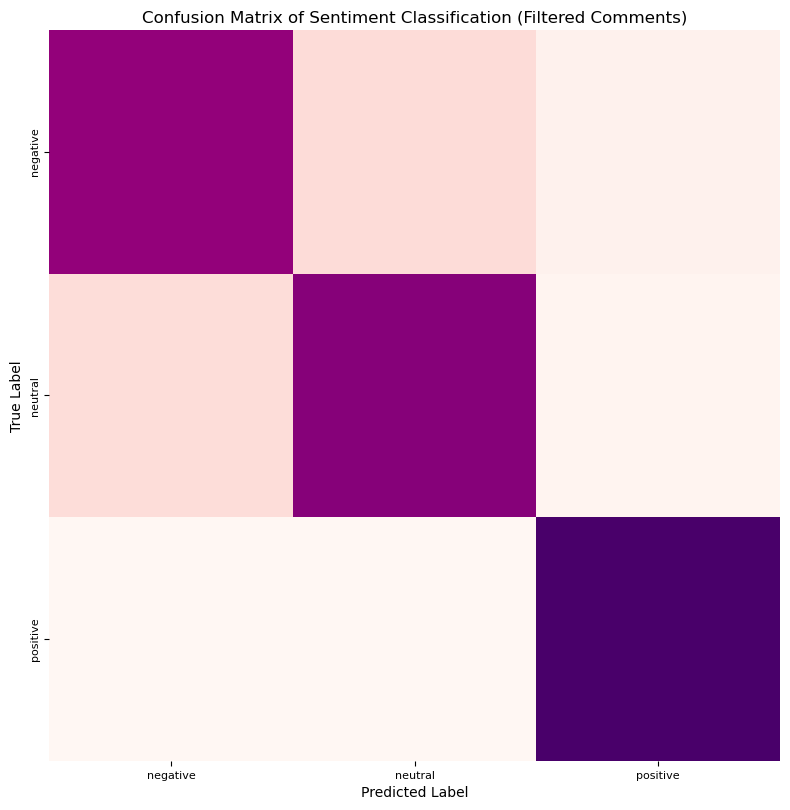

In [66]:
plt.figure(figsize=(8, 8))
h = sns.heatmap(normalized_confusion_matrix_comments_filtered, xticklabels=True, yticklabels=True, cmap = "RdPu", cbar=False)
h.set_xlabel('Predicted Label')
h.set_ylabel('True Label')
plt.xticks(ticks=[0.5, 1.5, 2.5], labels=['negative', 'neutral', 'positive'], fontsize=8)
plt.yticks(ticks=[0.5, 1.5, 2.5], labels=['negative', 'neutral', 'positive'], fontsize=8)
plt.tight_layout()
plt.title('Confusion Matrix of Sentiment Classification (Filtered Comments)')
plt.show()

The above heat map visualises the confusion matrix of the predicted vs true label. Given that the areas on the main diagonal are the 'hottest' this plot provides further evidence that the model does a relatively good job in classifying the comments. Note that out of the small sample of 100 comments only few were in fact positive. Hence it should not be overinterpreted that the model was able to correctly identify all of them. For a larger sample this most certainly will not be the case. When it comes to neutral and negative comments, the model also did a pretty good job, however the performance was slightly worse. Again, definitive conclusions cannot be made due to the ambiguous nature of many comments.<br><br>To gain an even more nuanced understanding of the model performance, the ROC curves are investigated for all three classes. For this purpose, the classification problem is artificially reduced to a binary decision problem: For each class the decision is 'belongs to class' or 'does not belong to class'. As the output of the RoBERTa model consists of the probabilities of an instance belonging to the different classes, a threshold parameter can be defined. In the below section the ROC curves are computed and plotted for all three classes.

In [67]:
#Compute ROC curve for different classification thresholds based on prob. output from model
sentiments_df = pd.DataFrame({'true_sentiment': actual_sentiment_top_100_filtered,
    'predicted_sentiment': comments_sentiment[top_100_comments_df_filtered.index]})

sentiments_df.reset_index(inplace=True,drop=True)

def extract_scores(predicted_list):
    scores = {label_sentiment_mapping[entry['label']]: entry['score'] for entry in predicted_list[0]}
    return scores

sentiments_df['scores'] = sentiments_df['predicted_sentiment'].apply(extract_scores)

#Binarise classes
classes = ['negative', 'neutral', 'positive']
class_bin = {'negative': (sentiments_df['true_sentiment'] == 'negative').astype(int),
             'neutral': (sentiments_df['true_sentiment'] == 'neutral').astype(int),
             'positive': (sentiments_df['true_sentiment'] == 'positive').astype(int)}

def add_to_roc_df(class_label, class_bin, sentiments_df):
    class_true = class_bin[class_label]
    class_scores = sentiments_df['scores'].apply(lambda x: x[class_label])

    fpr, tpr, thresholds = roc_curve(class_true, class_scores)
    roc_auc = auc(fpr, tpr)

    return pd.DataFrame({'fpr': fpr, 'tpr': tpr, 'thresholds': thresholds, 'auc': roc_auc})

roc_dfs = {}

for class_label in ['negative', 'neutral', 'positive']:
    roc_dfs[class_label] = add_to_roc_df(class_label, class_bin, sentiments_df)

negative_roc_df = roc_dfs['negative']
neutral_roc_df = roc_dfs['neutral']
positive_roc_df = roc_dfs['positive']

In [68]:
fig = go.Figure()

fig.add_trace(
    go.Scatter(x=negative_roc_df['fpr'],
               y=negative_roc_df['tpr'],
               name='negative (AUC = %0.2f)' % negative_roc_df['auc'][0],
               mode='lines',
               line=dict(color=colors[0]),
               opacity=0.75 ))

fig.add_trace(
    go.Scatter(x=neutral_roc_df['fpr'],
               y=neutral_roc_df['tpr'],
               name='neutral (AUC = %0.2f)' % neutral_roc_df['auc'][0],
               mode='lines',
               line=dict(color=colors[1]),
               opacity=0.75 ))

fig.add_trace(
    go.Scatter(x=positive_roc_df['fpr'],
               y=positive_roc_df['tpr'],
               name='positive (AUC = %0.2f)' % positive_roc_df['auc'][0],
               mode='lines',
               line=dict(color=colors[2]),
               opacity=0.75 ))

fig.add_trace(
    go.Scatter(x=[0, 1],
               y=[0, 1],
               mode='lines',
               line=dict(color='black', width=1, dash='dot'),
               showlegend=False))

fig.update_layout(template='plotly_white',
    showlegend=True,
    title='<b>Receiver Operating Characteristic curve for different Classes and Thresholds<b>',
    xaxis_title='False Positive Rate',
    yaxis_title='True Positive Rate',
    width=840,
    height=700)


fig.show()

In line with the previous analysis, the different ROC curves for the respective classes indicate a relatively good performance of the model in being able to identify the sentiment of a post.<br>As mentioned above, for the small sample of 100 comments, the model did a 'perfect job' in classifying positive comments. Given the very small size of the positive class however, this should not be over interpreted.<br><br> __Note:__ Due to the previously mentioned limitations these findings should be taken with a grain of salt and cannot be over interpreted. Especially, no definitive conclusions about the attitude towards the shared bikes can be made from this analysis. It merely can be deduced that the overall sentiment on the r/london subreddit on posts on the Santander bikes tends to be rather neutral to negative, which however does not necessarily indicate that people are dissatisfied with the service.
<br><br>To get an intuitive idea of some of the most common words in the analysed comments without having to read through thousands of (mostly dull) comments, a word cloud is constructed after having controlled for common stopwords and having further filtered for words with a minimum length.

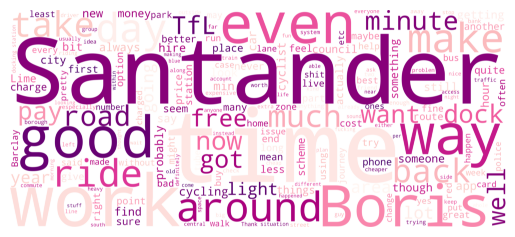

In [69]:
#word cloud
def filter_short_words(text):
    return ' '.join(word for word in text.split() if len(word) > 2)


words_wordcloud = ' '.join(comments_bikes_df_filtered['Cleaned Comment'].apply(filter_short_words))

stopwords = set(STOPWORDS)
additional_stopwords = {'Yeah', 'one', 'think', 'really','thing','know','people','used',
                        'will','call','see','need','use','London','bike','cycle','bikes','don'}
stopwords.update(additional_stopwords)

wordcloud = WordCloud(stopwords=stopwords,background_color='white',colormap=cm.RdPu,
                     width = 8000,height = 3500).generate(words_wordcloud)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

It might be surprising that one of the most common words in the comments is 'Boris'. However, this can easily be explained: The program was established under then Mayor of London Boris Johnson, which lead to the bikes frequently being called by their nickname 'Boris bikes'. <br><br>
__FINDINGS:__
* Comments left on r/london on Santander bikes are mostly neutral, however there is a tendency towards negative comments. As established, this does not necessarily mean that people are discontent with the bikes in general. Definitive conclusions about the sentiment towards the scheme cannot be made.
* Most of the time there is only little interest in the shared bikes online. However, once in a while major discussions break out. Some of theses discussions are fuled by external *relevant* events such as a price increase, but others simply start for no apparent reason.
* There seems to be no significant correlation between number of posts on r/London and number of bike rides.
* The RoBERTa model does a relatively good job in classifying comments according to their sentiment. However, taking sarcasm and irony into account the implemented model seems to have some issues.


## 4. Conclusions <a id="4"></a>
<br><br>
In conclusion, several insights can be noted, on which potential further research could be based on:<br><br>

1. The most popular stations include the ones located near Hyde Park and those close to major train stations like Waterloo station. It seems like depending on the location of the station, the bikes are either mostly used for recreational purpose (Hyde Park) and as a result are more likely to be returned to a docking station located near the start station or in the case of the train stations are mostly used by commuters, leading to a distribution of the bikes over the whole city. In the latter case, approximate round trips are very uncommon.<br><br>

2. It seems like usage patterns were not really affected by the introduction of newer bike models, however, this might not be conclusive due to the lack of data on newer models. Regarding the shared bikes in a broader context as part of the public transport, this seems to make sense: after all the dicision to ride a bus or not does not immediately depend on the model of the bus. Further research might investigate this aspect in more detail as this might imply a potential for cost-cutting.<br><br>

3. Unsurprisingly, it seems like there is a strong connection between the decision to hire a bike and the weather conditions. Furthermore, it seems like there are more bike hires in times of tube strikes. This might have implications on the daily re-distribution of bikes, which potentially can be optimised on a daily basis depending on external factors. Further research might investigate the connections of bicycle hires and external factors in more detail, potentially including an even broader set of covariates.<br><br>

4. Due to the previously mentioned limitations, no definitive conclusion can be reached in this point. However, it seems like neither the number of Reddit posts nor the actual sentiment on the London subreddit towards the bikes has a meaningful impact on bicycle hires. Especially, in 2022, when there was a lot of discontent among redditors because of price hikes, the TfL noted an all time record of hires. Given the extremely small community actively discussing the topic however, it might be reasonable to investigate other, more mainstream social networks including X (Twitter), Tripadvisor, Facebook or Instagram Threads. <br> The approach adopted in this analysis to perform the sentiment analysis with transformer based models seems to be very promising and could be further refined in future research.

__Limitations and Future Work:__ Note that there was not a lot of data on the newer bike models which might impair the reliability of the findings in the respective section. Also note the limitations mentioned earlier in connection with the sentiment analysis of the reddit comments. Furhtermore, not a lot of data on strike dates was available, potentially leading to unreliable results. Further research might consider taking this into account. Furhtermore, it might be interesting to enrich the data with further datasets including other strike data and to perform a more sophisticated analysis of online sentiment including other platforms mores suited for this kind of analysis.

## 5. References <a id="5"></a>


Francesco Barbieri, Jose Camacho-Collados, Luis Espinosa Anke, and Leonardo Neves. (2020) TweetEval: Unified Benchmark and Comparative Evaluation for Tweet Classification. In Findings of the Association for Computational Linguistics: EMNLP 2020, pages 1644–1650, Online. Association for Computational Linguistics. doi:10.18653/v1/2020.findings-emnlp.148 <br><br>
Liu, Y. et al. (2019) ‘RoBERTa: A Robustly Optimized BERT Pretraining Approach’, arXiv [cs.CL]. Available at: http://arxiv.org/abs/1907.11692.<br><br>

Santander. (2021) 'Santander Cycles, advocating sustainable transport in cities'. Available at: https://www.santander.com/en/stories/santander-cycles-advocating-sustainable-transport-in-cities (Accessed: 22 January 2024)<br><br>
Transport for London. (2009) 'Travel in London: Key trends and developments Report number 1'. Available at: https://content.tfl.gov.uk/travel-in-london-report-1-.pdf (Accessed: 23 January 2024) <br><br>
Transport for London. (2023) 'London’s iconic Santander Cycles hire scheme sees yet another record-breaking year in 2022'. Available at: https://tfl.gov.uk/info-for/media/press-releases/2023/january/london-s-iconic-santander-cycles-hire-scheme-sees-yet-another-record-breaking-year-in-2022 (Accessed: 22 January 2024)<br><br>

Neil Winton (2023) 'Europe’s ICE Ban Is Years Away, But The Pain Starts In 2024', Forbes, Oct 22, 2023.Available at: https://www.forbes.com/sites/neilwinton/2023/10/22/europes-ice-ban-is-years-away-but-the-pain-starts-in-2024/ (Accessed: 24 January 2024)
